In [2]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib import colors
import matplotlib
import seaborn as sns
import cartopy.crs as ccrs
#import gpflow
#import tensorflow as tf
import glob
#from xskillscore import crps_gaussian
#from scipy.stats import ttest_ind_from_stats as ttest
#from utils_GP import *
import pandas as pd
import os

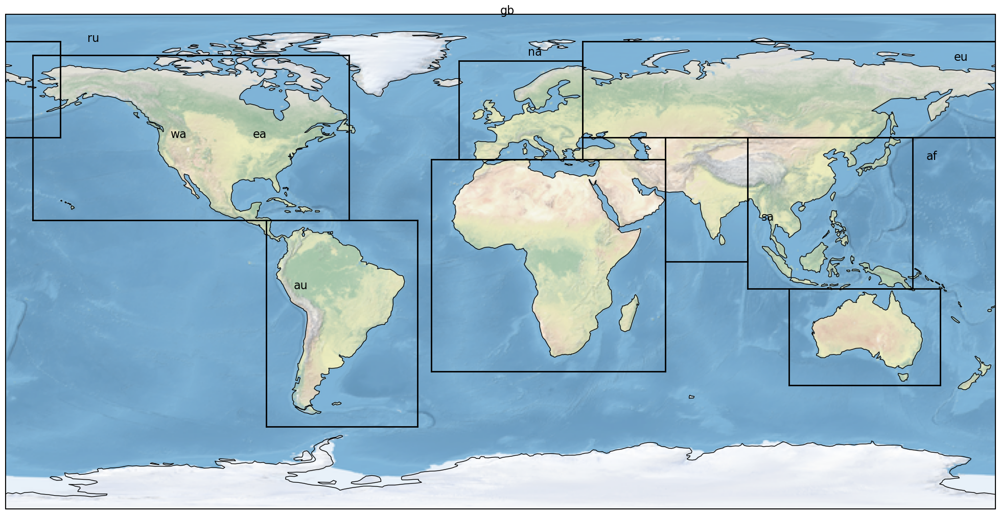

In [111]:
#test map of regions
fig = plt.figure(figsize=(25,14))
# Central map
ax_map = fig.add_subplot(projection=ccrs.PlateCarree())
ax_map.coastlines()
ax_map.stock_img()

#Europe, Russia, East Asia, South Asia, Australia, North America, South America, and Africa 

pert_regions_old = dict([
    ('gb', [0, -90, 360, 90]),
    ('eu', [165, 37, 210, 73]),
    ('ru', [210, 45, 380, 80]),
    ('ea', [270, -10, 330, 45]),
    ('wa', [240, 0, 270, 45]),
    ('au', [285, -45, 340, -10]),
    ('na', [10, 15, 125, 75]),
    ('sa', [95, -60, 150, 15]),
    ('af', [155, -40, 240, 37])
])

pert_regions_new = dict([
    ('gb', [0, -90, 360, 90]),
    ('ru', [50, 40, 180, 80]),
    ('sea', [92, -10, 150, 10]),
    ('nea', [92, 10, 150, 40]),
    ('wa', [60, 0, 92, 40]),
    ('au', [105, -45, 165, -10]),
    ('nna', [190, 15, 305, 49]),
    ('sna', [190, 49, 305, 80]),
    ('sa', [270, -60, 330, 15]),
    ('naf', [-25, 0, 60, 37]),
    ('saf', [-25, -40, 60, 0]),
    ('weu', [-25, 37, 20, 75]),
    ('eeu', [20, 37, 50, 75]),
])



#regions are defined as: [lower_left_lon, lower_left_lat, upper_right_lon, upper_right_lat]

def line_regions(ll_coord, ur_coord):
    c = 'k'
    lw = 2
    tf = ccrs.PlateCarree()
    ax_map.plot([ll_coord[0]-180,ur_coord[0]-180],[ll_coord[1],ll_coord[1]],transform=tf,color=c,linewidth=lw)
    ax_map.plot([ll_coord[0]-180,ur_coord[0]-180],[ur_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)
    ax_map.plot([ll_coord[0]-180,ll_coord[0]-180],[ll_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)
    ax_map.plot([ur_coord[0]-180,ur_coord[0]-180],[ll_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)

    
for key_region in pert_regions_old:
    
    line_regions(pert_regions_old[key_region][0:2], pert_regions_old[key_region][2:4])
    ax_map.annotate(key_region, xy=(pert_regions_old[key_region][0], pert_regions_old[key_region][3]), fontsize=16)

In [47]:
#define perturbation regions as  [lower_left_lon, lower_left_lat, upper_right_lon, upper_right_lat]
pert_regions = dict([
    ('gb', [0, -90, 360, 90]),
    ('ru', [60, 45, 180, 80]),
    ('ea', [95, -10, 150, 45]),
    ('wa', [60, 0, 95, 45]),
    ('au', [105, -45, 165, -10]),
    ('na', [190, 15, 305, 78]),
    ('sa', [270, -60, 330, 15]),
    ('af', [-25, -40, 60, 37]),
    ('eu', [-20, 37, 50, 75]),
])


def create_predictor_regions(pert_regions, data_set):
    #for given input dataset and coordingates of regions, sum emissions in those regions and return as dataframe.
    #note: emission units are Tg/yr per gridbox (so summing over lat/lon gives Tg/yr for that region) (not fluxes!)
    inputs = pd.DataFrame()
    X = data_set

    #for EU and AF, which cross the maridian, we need to adjust the longitude range to be between -180 and 180
    #make a copy of the dataset and adjust the longitude values:
    X_mod = X.copy()
    X_mod['lon'] = np.mod(X_mod['lon'] + 180, 360) - 180
    X_mod = X_mod.sortby(X_mod.lon)

    for key_region in pert_regions:

        #set up lat/lon slice values:
        lat_slice = slice(pert_regions[key_region][1],pert_regions[key_region][3])
        lon_slice = slice(pert_regions[key_region][0],pert_regions[key_region][2])

        #select from modified dataset if region is 'eu' or 'af':
        if key_region == 'eu' or key_region == 'af':
            Y_SO2 = X_mod['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X_mod['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X_mod['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)
        
        else:       
            Y_SO2 = X['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)

    return inputs

#prepare input data:
# data are annual emissions on 1.9x2.4 degree grid. For training we want a dataframe with total emissions for each region for each year and species, and then concatentate all experiments together.
# data is normalized by mean and std of each species for each experiment later.
# NaNs replaced with 0s.

def add_year(ds):
    #add year as a coordinate to the dataset if it doesn't exist (ie for equilibrium runs where year is not a coordinate)
    if 'year' in ds.coords:
        return ds
    else:
        ds = ds.assign_coords(year=9999)
        ds = ds.expand_dims('year')
        return ds

def prep_inputs(in_files):
    #loop over input files and create a dataframe of emissions for each pert region for each year and experiment.
    input_df = pd.DataFrame()

    data = xr.open_mfdataset(in_files, combine='nested', concat_dim='year', preprocess=add_year)

    inputs = create_predictor_regions(pert_regions, data)
    inputs0 = inputs.fillna(0)
    input_df = pd.concat([input_df, inputs0], axis=0)

    return input_df

In [20]:
def prep_outputs(out_files):

    output_df = pd.DataFrame()
    
    for file in out_files:
        print(file)
        data = xr.open_dataset(file)
        data = add_year(data)

        outputs = pd.DataFrame(data['tas_diff'].values.reshape(-1, 96 * 144),index=(data['year']))
        output_df = pd.concat([output_df, outputs], axis=0)

    if output_df.isnull().any(axis=1).sum()>0:
        print('NaNs found in output_df')
        #output_df = output_df.dropna()
        #input_df = input_df.dropna() #fix to drop same rows as output_df
        #print('NaNs dropped')

    return output_df

In [21]:
def setup_data(test_str, data_dir, external_test='None'):

    #data folders:
    in_files = glob.glob(data_dir + '/inputs*.nc')
    out_files = glob.glob(data_dir + '/outputs*.nc')

    #make train/test split
    #if external test data is provided, use that for testing
    print('Making train/test data split.', flush=True)
    if external_test != 'None':
        test_in = [external_test]
        print('Test experiment: ', external_test, flush=True)
    else:
        test_in = [s for s in in_files if test_str in s]
        print('Test experiment: ', test_str, flush=True)
    
    #by default 'test_str' is the held-out experiment (not including in training data, even if external test data is provided)
    print('Training experiments: ', flush=True)
    train_in = [s for s in in_files if test_str not in s]
    train_out = [s for s in out_files if test_str not in s]

    #prepare training data:
    train_input_df = prep_inputs(train_in)
    train_output_df = prep_outputs(train_out)

    #prepare test data:
    test_input_df = prep_inputs(test_in)
    
    #normalize data:
    out_norm, out_mean, out_std = normalize_data(train_output_df)
    in_norm, in_mean, in_std = normalize_data(train_input_df)

    #check array sizes are compatible:
    if (np.shape(in_norm)[0] == np.shape(out_norm)[0]):
        print ("Training input/output data shapes compatible.", flush=True)
        print("Test inputs file: ", test_in, flush=True)
    else:
        print("Error! Training data is mis-shapen!", flush=True)
        sys.exit()

    #normalize test data:
    test_in_norm = (test_input_df - in_mean) / in_std

    #test data name for saving:
    test_name = os.path.splitext(os.path.basename(test_in[0]))[0].split('_',1)[1]

    #coords for test output:
    test_inputs = xr.open_dataset(test_in[0])['SO2']
    out_coords = test_inputs.coords
    out_dims = test_inputs.dims
    out_shape = np.shape(test_inputs)

    return out_norm, out_mean, out_std, in_norm, test_in_norm, out_coords, out_dims, out_shape, test_name


In [5]:
def lat_weighted_mean(x):
    weights = np.cos(np.deg2rad(x.lat))
    return x.weighted(weights).mean(['lat', 'lon'])

def lat_weighted_sum(x):
    weights = np.cos(np.deg2rad(x.lat))
    return x.weighted(weights).sum(['lat', 'lon'])

def normalize_data(data):
    #normalize data by mean and std
    mean = data.mean()
    std = data.std()
    data = (data - mean) / std
    return data, mean, std


In [27]:
#setup train/test data
data_dir='C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2/'
test_dir='hist-aer'
external_test = 'None'
train_output_norm, out_mean, out_std, train_input_norm, test_input_norm, out_coords, out_dims, out_shape, test_name = setup_data(test_dir, data_dir, external_test)
num_data = len(train_input_norm)
training_data = (train_input_norm.astype(np.float64), train_output_norm.astype(np.float64))


Making train/test data split.
Test experiment:  hist-aer
Training experiments: 
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_0xEA_SO2.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_0xEU_SO2.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_0xNA_SO2.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_0xSA_SO2.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_10xEU_BC.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_10xNA_BC.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_10xSA_BC.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_10xSA_SO2.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_5xEA_BC.nc
C:/Users/made2928/OneDrive/Documents/MISU/NorESMem/training_data_v2\outputs_5xEA_SO2.nc
C:/Users/made2928/OneDrive/Documents/MIS

In [28]:
train_output_norm.shape

(456, 13824)

In [29]:
N = num_data
minibatch_size = 200
data_minibatch = (
    tf.data.Dataset.from_tensor_slices(training_data)
    .repeat()
    .shuffle(N)
    .batch(minibatch_size))
train_dataset = iter(data_minibatch)

In [32]:
data_minibatch

<_BatchDataset element_spec=(TensorSpec(shape=(None, 27), dtype=tf.float64, name=None), TensorSpec(shape=(None, 13824), dtype=tf.float64, name=None))>

In [5]:
#load training data

inputs_ALL = xr.open_mfdataset('../training_data_v2/inputs_*.nc',combine='nested',concat_dim='year',preprocess=add_year)

<Axes: xlabel='year'>

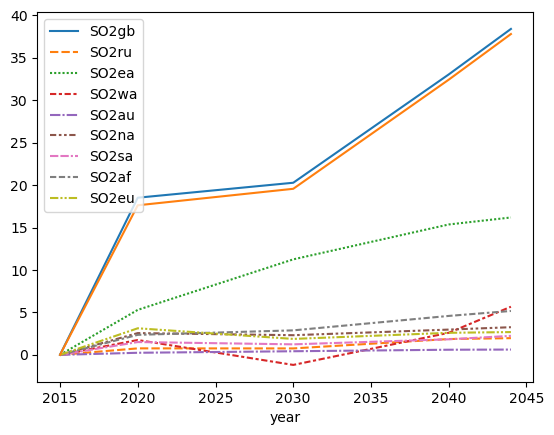

In [74]:
X_asinput = prep_inputs('../training_data_v2/inputs_AeroGP1.nc')
sns.lineplot(data=X_asinput.filter(like='SO2'))
sns.lineplot(data=X_asinput.filter(like='SO2').drop(columns='SO2gb').sum(axis=1))

In [75]:
X_asinput

,SO2gb,BCgb,OCgb,SO2ru,BCru,OCru,SO2ea,BCea,OCea,SO2wa,...,OCna,SO2sa,BCsa,OCsa,SO2af,BCaf,OCaf,SO2eu,BCeu,OCeu
year,,,,,,,,,,,,,,,,,,,,,
2015,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0
2016,3.703453,-0.206893,0.0,0.152820,0.003277,0.0,1.060185,-0.047540,0.0,0.349797,...,0.0,0.301892,-0.012122,0.0,0.471827,-0.096202,0.0,0.626167,0.010563,0.0
2017,7.406906,-0.413786,0.0,0.305641,0.006553,0.0,2.120370,-0.095081,0.0,0.699595,...,0.0,0.603784,-0.024244,0.0,0.943653,-0.192404,0.0,1.252334,0.021126,0.0
2018,11.110359,-0.620680,0.0,0.458461,0.009830,0.0,3.180554,-0.142621,0.0,1.049392,...,0.0,0.905676,-0.036366,0.0,1.415480,-0.288606,0.0,1.878500,0.031689,0.0
2019,14.813812,-0.827573,0.0,0.611282,0.013107,0.0,4.240739,-0.190161,0.0,1.399190,...,0.0,1.207567,-0.048488,0.0,1.887307,-0.384808,0.0,2.504667,0.042252,0.0
2020,18.517265,-1.034466,0.0,0.764102,0.016383,0.0,5.300924,-0.237702,0.0,1.748987,...,0.0,1.509459,-0.060610,0.0,2.359133,-0.481010,0.0,3.130834,0.052815,0.0
2021,18.693526,-1.213333,0.0,0.763426,0.015518,0.0,5.896042,-0.280262,0.0,1.455454,...,0.0,1.482430,-0.071492,0.0,2.411803,-0.537178,0.0,3.005498,0.045700,0.0
2022,18.869786,-1.392200,0.0,0.762751,0.014653,0.0,6.491159,-0.322823,0.0,1.161920,...,0.0,1.455401,-0.082375,0.0,2.464472,-0.593346,0.0,2.880162,0.038586,0.0
2023,19.046047,-1.571066,0.0,0.762075,0.013787,0.0,7.086276,-0.365384,0.0,0.868387,...,0.0,1.428372,-0.093258,0.0,2.517141,-0.649513,0.0,2.754827,0.031472,0.0


In [44]:
xr.open_dataset('../training_data_v2/inputs_hist-aer.nc')

<xarray.Dataset> Size: 55MB
Dimensions:  (year: 165, lat: 96, lon: 144)
Coordinates:
  * year     (year) int64 1kB 1850 1851 1852 1853 1854 ... 2011 2012 2013 2014
  * lat      (lat) float64 768B -90.0 -88.11 -86.21 -84.32 ... 86.21 88.11 90.0
  * lon      (lon) float64 1kB 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
Data variables:
    SO2      (year, lat, lon) float64 18MB ...
    BC       (year, lat, lon) float64 18MB ...
    OC       (year, lat, lon) float64 18MB ...
Attributes:
    units:          Tg/yr
    experiment_id:  hist-aer

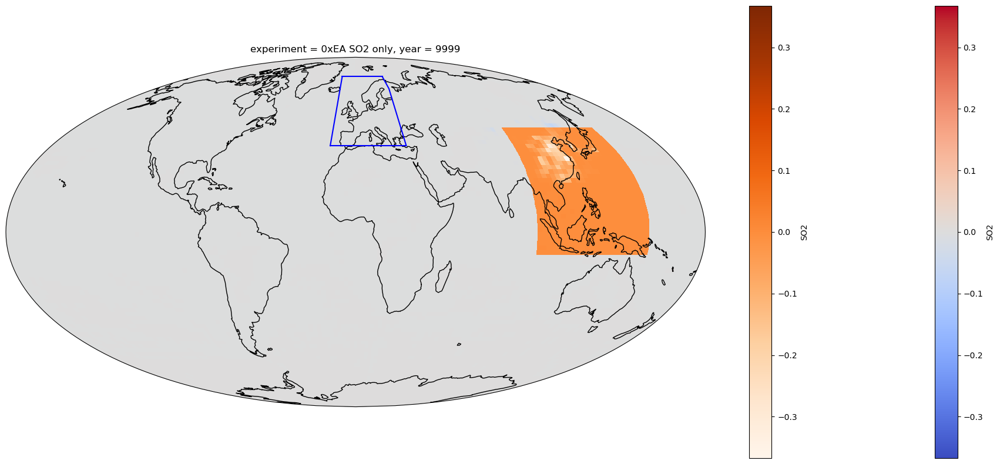

In [ ]:
fig = plt.figure(figsize=(24, 10))
tf1 = ccrs.PlateCarree()
tf2 = ccrs.PlateCarree(central_longitude=180.0)
ax = plt.axes(projection=ccrs.Mollweide())
ax.coastlines()


#plot global mean tas:
inputs_ALL.SO2[0].plot(transform=tf, cmap="coolwarm")

#set up lat/lon slice values:
lat_slice = slice(dict_regions['ea'][1],dict_regions['ea'][3])
lon_slice = slice(dict_regions['ea'][0],dict_regions['ea'][2])

pltSO2 = inputs_ALL.SO2[0].sel(lat=lat_slice,lon=lon_slice)

pltSO2.plot(transform=tf, cmap="Oranges")

#regions are defined as: [lower_left_lon, lower_left_lat, upper_right_lon, upper_right_lat]

#def line_regions(ll_coord, ur_coord):
#    c = 'k'
#    lw = 2
#    tf = ccrs.PlateCarree()
#    ax.plot([ll_coord[0],ll_coord[0]],[ll_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)
#    ax.plot([ll_coord[1],ll_coord[1]],[ll_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)
#    ax.plot([ll_coord[0],ur_coord[0]],[ll_coord[1],ll_coord[1]],transform=tf,color=c,linewidth=lw)
#    ax.plot([ll_coord[0],ur_coord[0]],[ur_coord[1],ur_coord[1]],transform=tf,color=c,linewidth=lw)

#for key_region in pert_regions:
#    if key_region == 'gb':
#        continue
#    line_regions(pert_regions[key_region][0:2], pert_regions[key_region][2:4])

#lat_slice = slice(pert_regions[key_region][1],pert_regions[key_region][3])
#lon_slice = slice(pert_regions[key_region][0],pert_regions[key_region][2])

ax.plot([165,165],[37,73],transform=tf2,color='blue')
ax.plot([210,210],[37,73],transform=tf2,color='blue')
ax.plot([165,210],[37,37],transform=tf2,color='blue')
ax.plot([165,210],[73,73],transform=tf2,color='blue')

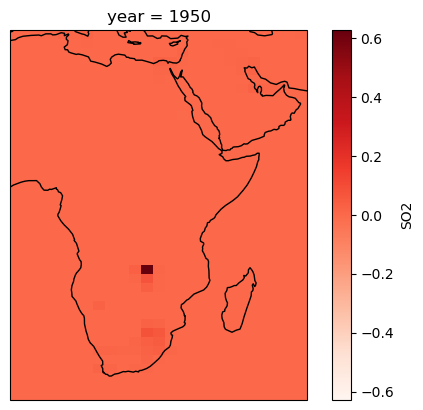

In [ ]:
#check input data

X = xr.open_dataset('../training_data_v3/inputs_hist-aer.nc')

region = 'af'

lat_slice = slice(dict_regions[region][1],dict_regions[region][3])
lon_slice = slice(dict_regions[region][0],dict_regions[region][2])

Y_SO2 = X['SO2'].sel(lat=lat_slice,lon=lon_slice)
Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice)
Y_OC = X['OC'].sel(lat=lat_slice,lon=lon_slice)


fig = plt.figure()
tf = ccrs.PlateCarree()
ax = plt.axes(projection=tf)
ax.coastlines()
Y_SO2[100].plot(transform=tf2, cmap="Reds")

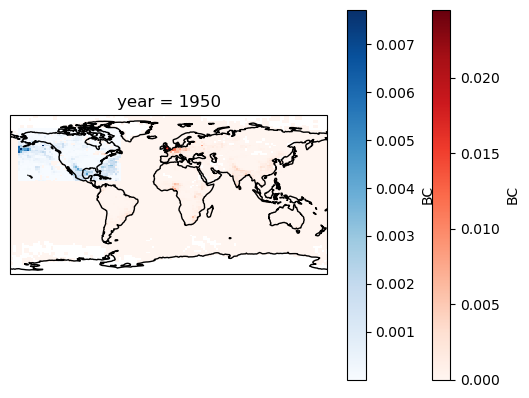

In [ ]:
fig = plt.figure()
tf = ccrs.PlateCarree()
ax = plt.axes(projection=tf)
ax.coastlines()
X.BC[100].where(X.BC[100]>0).plot(cmap="Reds")

region = 'na'

lat_slice = slice(pert_regions[region][1],pert_regions[region][3])
lon_slice = slice(pert_regions[region][0],pert_regions[region][2])

Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice)

Y_BC[100].where(Y_BC[100]>0).plot(transform=tf2,cmap="Blues")

In [ ]:
X = xr.open_dataset('../training_data_v3/inputs_hist-aer.nc')

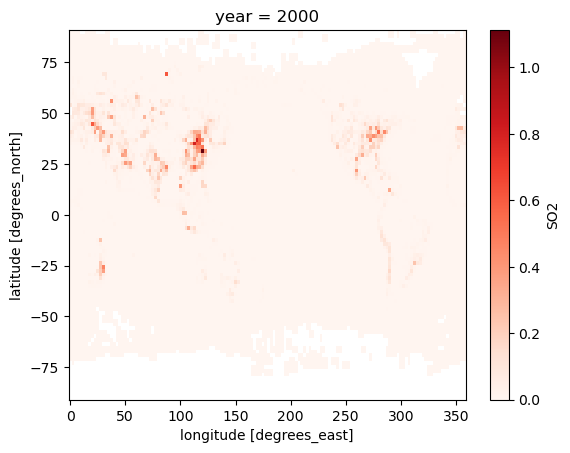

In [ ]:
X.SO2[150].where(X.SO2[150]>0).plot(cmap='Reds')

In [ ]:
# ('eu', [-20, 37, 60, 75])

# Adjust the longitude range to be between -180 and 180
X_mod = X.copy()
X_mod['lon'] = np.mod(X_mod['lon'] + 180, 360) - 180
X_mod = X_mod.sortby(X_mod.lon)

# Now select using a single slice along the adjusted longitude range
X_eu=X_mod.sel(lat=slice(37, 75), lon=slice(-20, 50))

#('af', [-25, -40, 60, 37])
X_af = X_mod.sel(lat=slice(-40,37), lon=slice(-25,60))



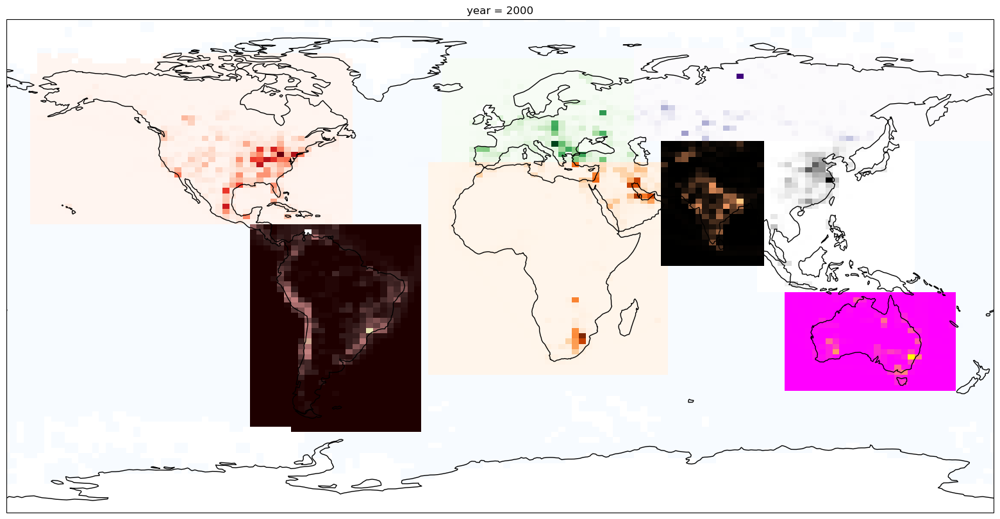

In [ ]:
fig = plt.figure(figsize=(20, 10))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
X.SO2[150].where(X.SO2[150]>0).plot(cmap='Blues',label='Global',add_colorbar=False)
X.sel(lat=slice(15,78),lon=slice(190,305)).SO2[150].where(X.SO2[150]>0).plot(cmap='Reds',label='North America',add_colorbar=False)
X_eu.SO2[150].where(X_eu.SO2[150]>0).plot(cmap='Greens',label='Europe',add_colorbar=False)
X_af.SO2[150].where(X_af.SO2[150]>0).plot(cmap='Oranges',label='Africa',add_colorbar=False)
X.sel(lat=slice(45,80),lon=slice(50,180)).SO2[150].where(X.SO2[150]>0).plot(cmap='Purples',label='Russia',add_colorbar=False)
X.sel(lat=slice(-10,45),lon=slice(95,150)).SO2[150].where(X.SO2[150]>0).plot(cmap='Greys',label='East Asia',add_colorbar=False)
X.sel(lat=slice(0,45),lon=slice(60,95)).SO2[150].where(X.SO2[150]>0).plot(cmap='copper',label='West Asia',add_colorbar=False)
X.sel(lat=slice(-60,15),lon=slice(270,330)).SO2[150].where(X.SO2[150]>0).plot(cmap='pink',label='South America',add_colorbar=False)
X.sel(lat=slice(-45,-10),lon=slice(105,165)).SO2[150].where(X.SO2[150]>0).plot(cmap='spring',label='Australia',add_colorbar=False)


In [108]:
#re-write section of utils_GP and test:



def create_predictor_regions(pert_regions, data_set):
    #for given input dataset and coordingates of regions, sum emissions in those regions and return as dataframe.
    #note: emission units are Tg/yr per gridbox (so summing over lat/lon gives Tg/yr for that region) (not fluxes!)
    inputs = pd.DataFrame()
    X = data_set

    #for EU and AF, which cross the maridian, we need to adjust the longitude range to be between -180 and 180
    #make a copy of the dataset and adjust the longitude values:
    X_mod = X.copy()
    X_mod['lon'] = np.mod(X_mod['lon'] + 180, 360) - 180
    X_mod = X_mod.sortby(X_mod.lon)

    for key_region in pert_regions:

        #set up lat/lon slice values:
        lat_slice = slice(pert_regions[key_region][1],pert_regions[key_region][3])
        lon_slice = slice(pert_regions[key_region][0],pert_regions[key_region][2])

        #select from modified dataset if region is 'eu' or 'af':
        if key_region == 'eu' or key_region == 'af':
            Y_SO2 = X_mod['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X_mod['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X_mod['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)
        
        else:       
            Y_SO2 = X['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)

    return inputs

def add_year(ds):
    #add year as a coordinate to the dataset if it doesn't exist (ie for equilibrium runs where year is not a coordinate)
    if 'year' in ds.coords:
        return ds
    else:
        ds = ds.assign_coords(year=9999)
        ds = ds.expand_dims('year')
        return ds

def prep_inputs(in_files):
    #loop over input files and create a dataframe of emissions for each pert region for each year and experiment.
    input_df = pd.DataFrame()

    data = xr.open_mfdataset(in_files, combine='nested', concat_dim='year', preprocess=add_year)

    inputs = create_predictor_regions(pert_regions, data)
    inputs0 = inputs.fillna(0)
    input_df = pd.concat([input_df, inputs0], axis=0)

    return input_df

In [109]:
pert_regions = dict([
    ('gb', [0, -90, 360, 90]),
    #('ru', [55, 45, 180, 80]),
    ('ea', [95, -10, 150, 45]),
    ('wa', [60, 0, 95, 45]),
    #('au', [105, -45, 165, -10]),
    ('na', [190, 15, 305, 78]),
    #('sa', [270, -60, 330, 15]),
    ('af', [-25, -40, 60, 45]),
    ('eu', [-20, 45, 55, 80]),
])


def create_predictor_regions(pert_regions, data_set):
#    #for given input dataset and coordingates of regions, sum emissions in those regions and return as dataframe.
#    #note: emission units are Tg/yr per gridbox (so summing over lat/lon gives Tg/yr for that region) (not fluxes!)
    inputs = pd.DataFrame()
    X = data_set

    #for EU and AF, which cross the maridian, we need to adjust the longitude range to be between -180 and 180
    #make a copy of the dataset and adjust the longitude values:
    X_mod = X.copy()
    X_mod['lon'] = np.mod(X_mod['lon'] + 180, 360) - 180
    X_mod = X_mod.sortby(X_mod.lon)

    for key_region in pert_regions:

#        #set up lat/lon slice values:
        lat_slice = slice(pert_regions[key_region][1],pert_regions[key_region][3])
        lon_slice = slice(pert_regions[key_region][0],pert_regions[key_region][2])

        #select from modified dataset if region is 'eu' or 'af':
        if key_region == 'eu' or key_region == 'af':
            Y_SO2 = X_mod['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X_mod['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X_mod['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)
        
        else:       
            Y_SO2 = X['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)

    #add three more columns for the rest of the emissions (glb-sum of others)
    inputs['SO2rest'] = inputs['SO2gb'] - (inputs.filter(like='SO2').drop(columns='SO2gb').sum(axis=1))
    inputs['BCrest'] = inputs['BCgb'] - (inputs.filter(like='BC').drop(columns='BCgb').sum(axis=1))
    inputs['OCrest'] = inputs['OCgb'] - (inputs.filter(like='OC').drop(columns='OCgb').sum(axis=1))

    return inputs

#prepare input data:
# data are annual emissions on 1.9x2.4 degree grid. For training we want a dataframe with total emissions for each region for each year and species, and then concatentate all experiments together.
# data is normalized by mean and std of each species for each experiment later.
# NaNs replaced with 0s.

def add_year(ds):
    #add year as a coordinate to the dataset if it doesn't exist (ie for equilibrium runs where year is not a coordinate)
    if 'year' in ds.coords:
        return ds
    else:
        ds = ds.assign_coords(year=9999)
        ds = ds.expand_dims('year')
        return ds

def prep_inputs(in_files):
    #loop over input files and create a dataframe of emissions for each pert region for each year and experiment.
    input_df = pd.DataFrame()

    data = xr.open_mfdataset(in_files, combine='nested', concat_dim='year', preprocess=add_year)

    inputs = create_predictor_regions(pert_regions, data)
    inputs0 = inputs.fillna(0)
    input_df = pd.concat([input_df, inputs0], axis=0)

    return input_df


In [60]:
#X = xr.open_dataset('../training_data_v3/inputs_hist-aer.nc')

X_asinput = prep_inputs('../training_data_v2/inputs_ramip_t1.nc')

In [61]:
X_asinput.columns

Index(['SO2gb', 'BCgb', 'OCgb', 'SO2ea', 'BCea', 'OCea', 'SO2wa', 'BCwa',
       'OCwa', 'SO2na', 'BCna', 'OCna', 'SO2af', 'BCaf', 'OCaf', 'SO2eu',
       'BCeu', 'OCeu', 'SO2rest', 'BCrest', 'OCrest'],
      dtype='object')

<Axes: xlabel='year'>

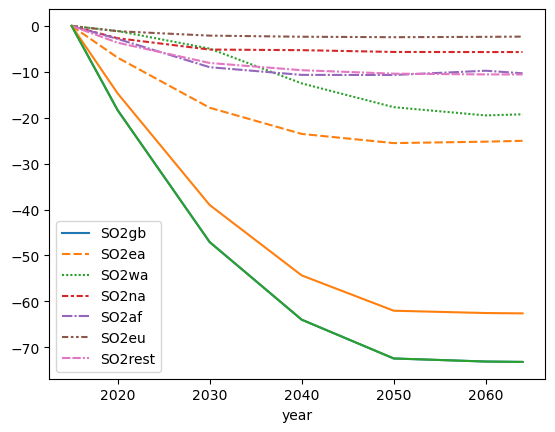

In [62]:
sns.lineplot(data=X_asinput.filter(like='SO2'))
sns.lineplot(data=X_asinput.filter(like='SO2').drop(columns=['SO2gb','SO2rest']).sum(axis=1))
sns.lineplot(data=X_asinput.filter(like='SO2').drop(columns=['SO2gb']).sum(axis=1))

In [110]:

def prep_inputs_old(in_files):
    #loop over input files and create a dataframe of emissions for each pert region for each year and experiment.
    input_df = pd.DataFrame()

    data = xr.open_mfdataset(in_files, combine='nested', concat_dim='year', preprocess=add_year)

    inputs = create_predictor_regions(pert_regions_old, data)
    inputs0 = inputs.fillna(0)
    input_df = pd.concat([input_df, inputs0], axis=0)

    return input_df

X_asinput_old = prep_inputs_old('../training_data_v3/inputs_hist-aer.nc')

NameError: name 'pert_regions_old' is not defined

<Axes: xlabel='year'>

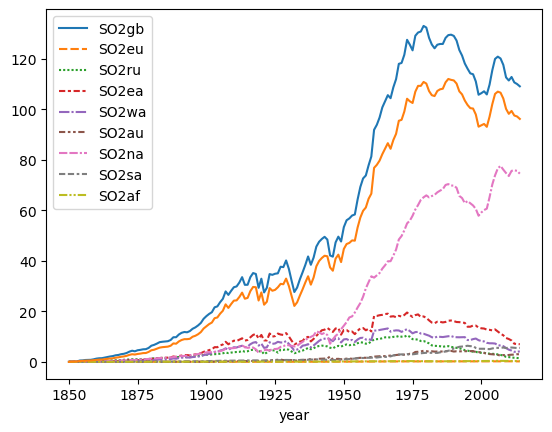

In [7]:
sns.lineplot(data=X_asinput_old.filter(like='SO2'))
sns.lineplot(data=X_asinput_old.filter(like='SO2').drop(columns='SO2gb').sum(axis=1))

In [106]:
from utils_GP_experimental import prep_inputs
X_asinput = prep_inputs('../training_data_v2/inputs_hist-aer.nc')

<Axes: xlabel='year'>

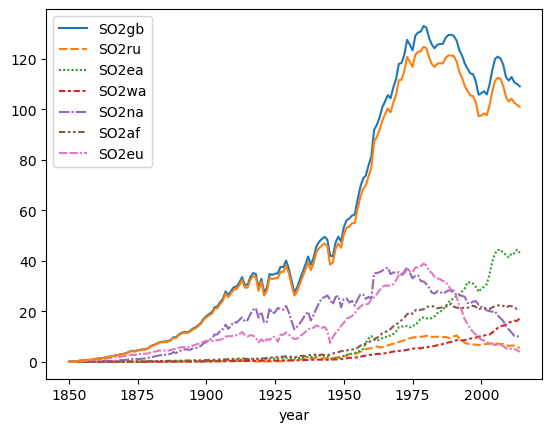

In [112]:
sns.lineplot(data=X_asinput.filter(like='SO2'))
sns.lineplot(data=X_asinput.filter(like='SO2').drop(columns='SO2gb').sum(axis=1))

# plots to look at version testing:

In [4]:
def plot_sig_comparison(ds1, ds2, years):
    plt.figure(figsize=(10,5))
    fig, ax = plt.subplots(2,1, figsize=(10, 10), subplot_kw={'projection': ccrs.Robinson()})
    norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
    ds1['posterior'].sel(year=years).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
    ax[0].pcolor(ds1.lon, ds1.lat, ds1['posterior'].where(np.abs(ds1['posterior'])>0.5*ds1['posterior std']).sel(year=years).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
    ax[0].coastlines()
    ax[0].set_title('dataset 1')   

    ds2['posterior'].sel(year=years).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
    ax[1].pcolor(ds2.lon, ds2.lat, ds2['posterior'].where(np.abs(ds2['posterior'])>0.5*ds2['posterior std']).sel(year=years).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
    ax[1].coastlines()
    ax[1].set_title('dataset 2')

<Figure size 1000x500 with 0 Axes>

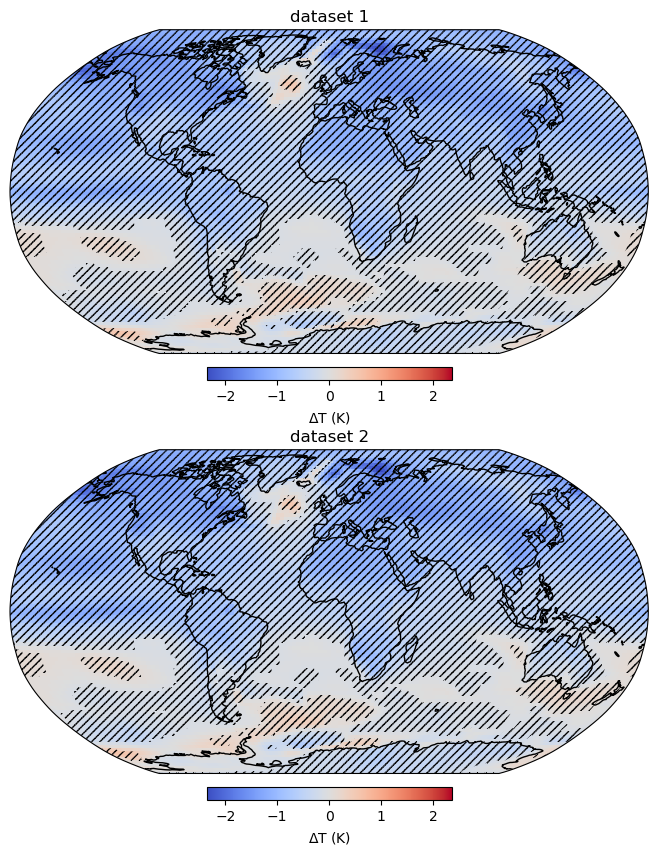

In [16]:
ssp245_aer = xr.open_dataset('../logs/logs_ssp245-aer/posterior_predictY_ssp245-aer_20250304-110103.nc')
plot_sig_comparison(ssp245_aer,ssp245_aer,slice(2021,2040))

In [6]:
ramipt1_1 = xr.open_dataset('../logs/testing/logs_RAMIP T1 lessregions/posterior_predictY_ramip_t1_20250319-062403.nc')
ramipt1_2 = xr.open_dataset('../logs/testing/ramip_t1_lessregions_2/posterior_predictY_ramip_t1_20250320-222552.nc')

Text(0.5, 1.0, '6000 mi')

<Figure size 600x500 with 0 Axes>

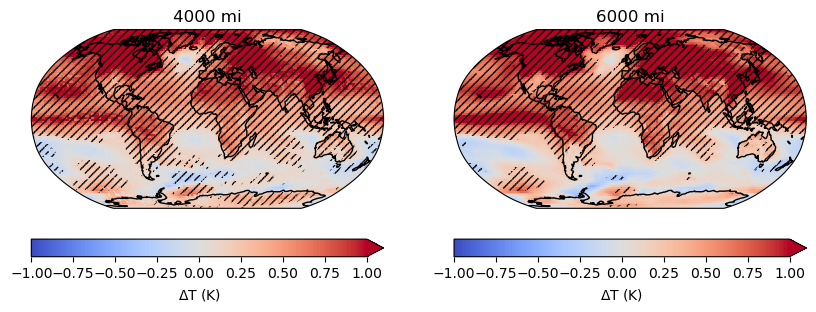

In [9]:
years = slice(2045,2064)
data=ramipt1_1
data_old=ramipt1_2

plt.figure(figsize=(6,5))
fig, ax = plt.subplots(1,2,figsize=(10, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
data['posterior'].sel(year=years).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), norm=norms, cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[0].pcolor(data.lon, data.lat, data['posterior'].where(np.abs(data['posterior'])>0.5*data['posterior std']).sel(year=years).mean('year'), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[0].coastlines()
ax[0].set_title('4000 mi')

data_old['posterior'].sel(year=years).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), norm=norms, cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[1].pcolor(data_old.lon, data_old.lat, data_old['posterior'].where(np.abs(data_old['posterior'])>0.75*data_old['posterior std']).sel(year=years).mean('year'), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[1].coastlines()
ax[1].set_title('6000 mi')

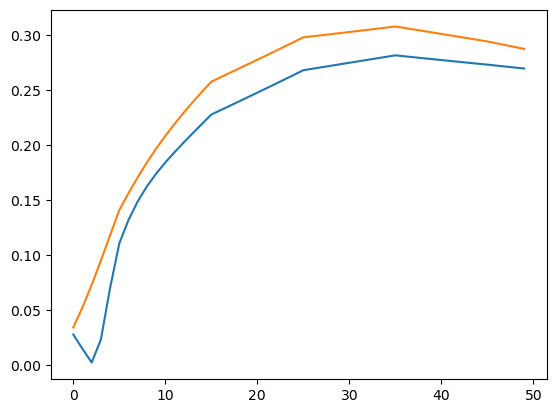

In [74]:
data = xr.open_dataset('../logs/testing/ramipea_lessregions_60ip/posterior_predictY_ramipEA2_20250319-000918.nc')
data_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP EA/posterior_predictY_ramipEA2_20250121-175129.nc')
#data_feb = xr.open_dataset('../logs/logs_RAMIP EA/posterior_predictY_ramip_ea_20250305-043748.nc')
#data = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1_thismodel_newregions.nc')
#data_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')
#data = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP EA/posterior_predictY_ramip_ea_thismodel_newregions.nc')
#data_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP EA/posterior_predictY_ramip_ea.nc')

plt.plot(lat_weighted_mean(data_old['posterior']))
plt.plot(lat_weighted_mean(data['posterior']))
#plt.plot(lat_weighted_mean(data_feb['posterior']))

Text(0.5, 1.0, 'old')

<Figure size 600x500 with 0 Axes>

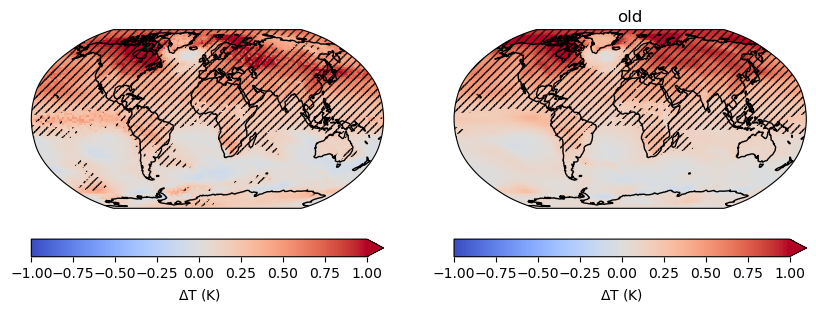

In [75]:
#look for which regional experiment has a robust signal in the posterior:
years = slice(2045,2064)

plt.figure(figsize=(6,5))
fig, ax = plt.subplots(1,2,figsize=(10, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
data['posterior'].sel(year=years).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), norm=norms, cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[0].pcolor(data.lon, data.lat, data['posterior'].where(np.abs(data['posterior'])>0.5*data['posterior std']).sel(year=years).mean('year'), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[0].coastlines()

data_old['posterior'].sel(year=years).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), norm=norms, cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[1].pcolor(data_old.lon, data_old.lat, data_old['posterior'].where(np.abs(data_old['posterior'])>0.5*data_old['posterior std']).sel(year=years).mean('year'), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[1].coastlines()
ax[1].set_title('old')

In [7]:
ramipea_linearsplit = xr.open_dataset('../logs/testing/logs_RAMIP EA linear split/posterior_predictY_ramip_ea_20250318-124757.nc')
ramip_feb = xr.open_dataset('../logs/logs_RAMIP EA/posterior_predictY_ramip_ea_20250305-043748.nc')

<Figure size 1000x500 with 0 Axes>

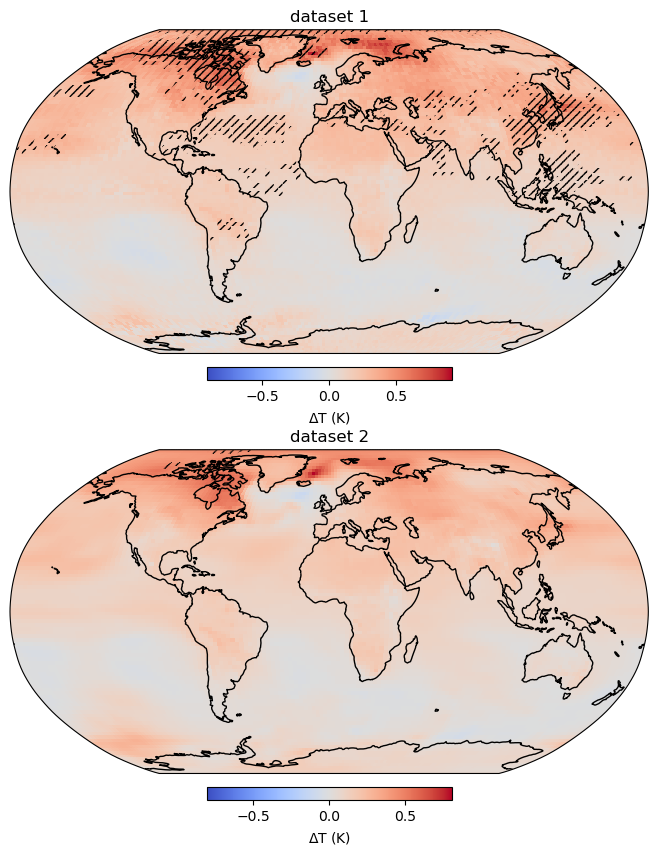

In [8]:
plot_sig_comparison(ramipea_linearsplit, ramip_feb, slice(2055,2065))

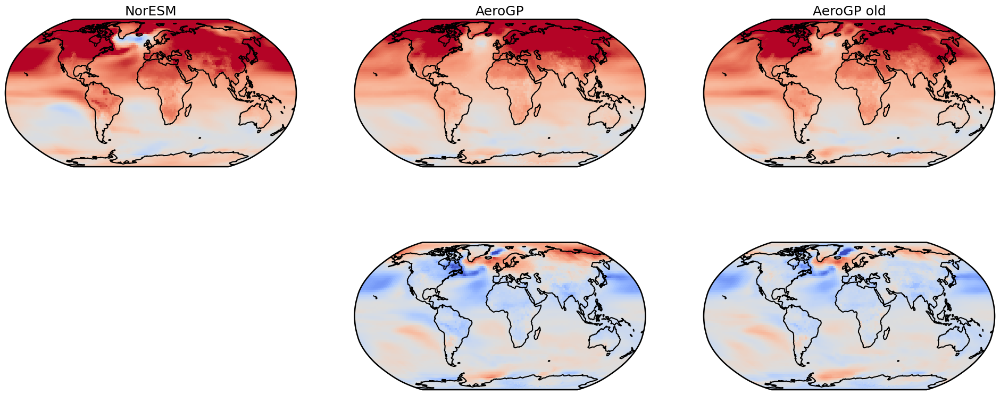

In [ ]:
ramip_NorESM = xr.open_dataset('../training_data_v3/outputs_ramip_t1.nc')
ramip_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')
ramip_AeroGP = xr.open_dataset('../logs/logs_RAMIP T1/posterior_predictY_ramip_t1_20250225-142245.nc')

ramip_NorESM_mean = ramip_NorESM['tas_diff'].sel(year=slice(2045,2065)).mean('year')
ramip_AeroGP_mean = ramip_AeroGP['posterior'].sel(year=slice(2045,2065)).mean('year')
ramip_AeroGP_old_mean = ramip_AeroGP_old['posterior'].sel(year=slice(2045,2065)).mean('year')


divnorm1 = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
    ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    ramip_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    ramip_AeroGP_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    ramip_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (ramip_AeroGP_mean - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (ramip_AeroGP_old_mean - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
   
 

In [8]:
def lat_weighted_mean(x):
    weights = np.cos(np.deg2rad(x.lat))
    return x.weighted(weights).mean(['lat', 'lon'])

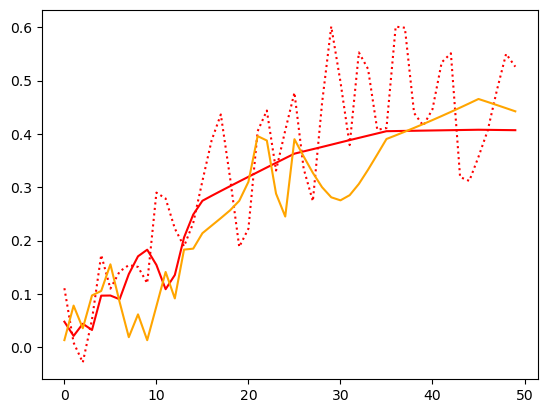

In [ ]:
plt.plot(lat_weighted_mean(ramip_AeroGP['posterior']),color='r')
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='r')
plt.plot(lat_weighted_mean(ramip_AeroGP_old['posterior']),color='orange')

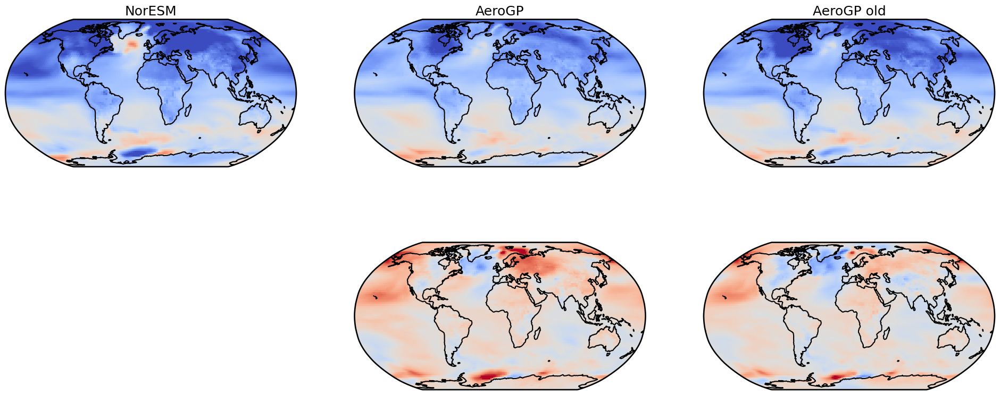

In [28]:
#everything the same, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-150451.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].sel(year=slice(2000,2020)).mean('year')
histaer_AeroGP_mean = histaer_AeroGP['posterior'].sel(year=slice(2000,2020)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].sel(year=slice(2000,2020)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

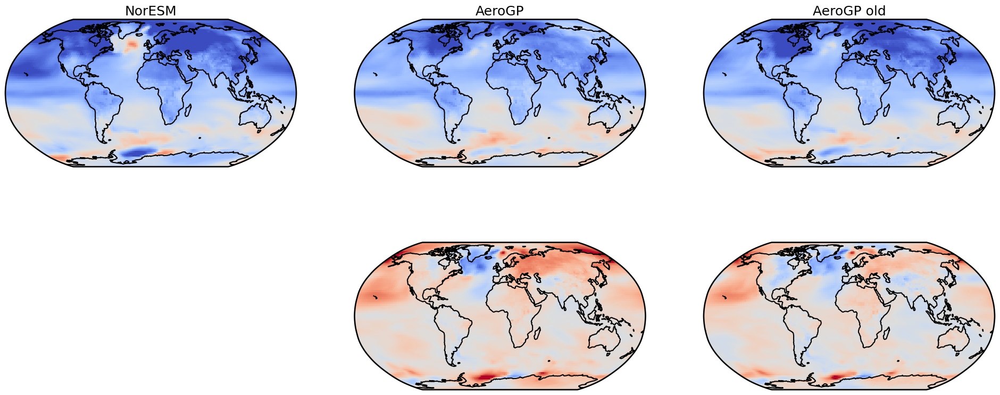

In [40]:
#using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP2 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-154947.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].sel(year=slice(2000,2020)).mean('year')
histaer_AeroGP_mean2 = histaer_AeroGP2['posterior'].sel(year=slice(2000,2020)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].sel(year=slice(2000,2020)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean2.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean2 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()



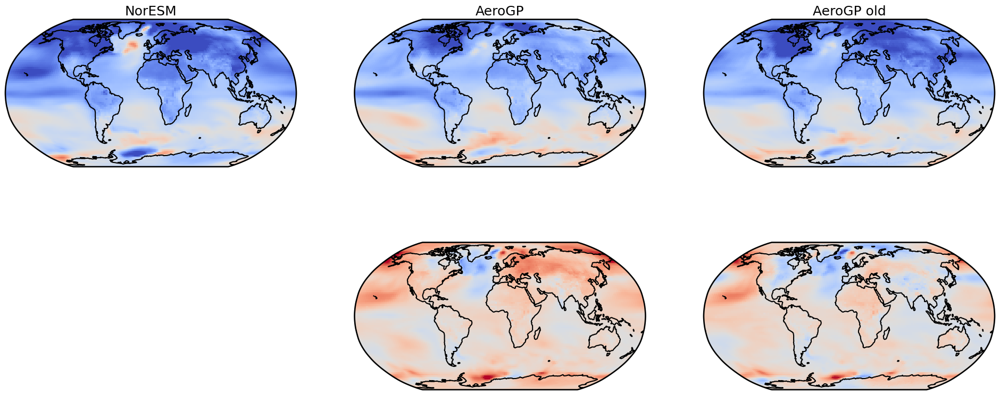

In [46]:
#extend new eu to 60 lon, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP3 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-162801.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean3 = histaer_AeroGP3['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean3.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean3 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

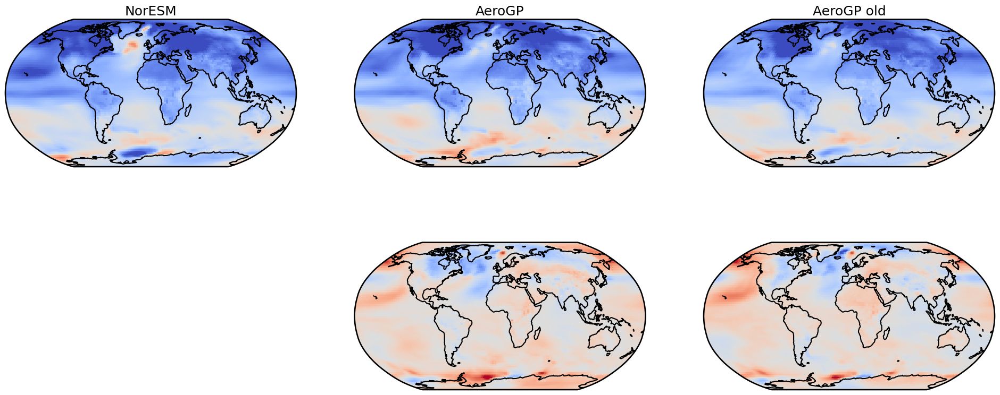

In [47]:
#eu back to 50, 100 inducing points, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP4 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-171134.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean4 = histaer_AeroGP4['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean4.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean4 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()


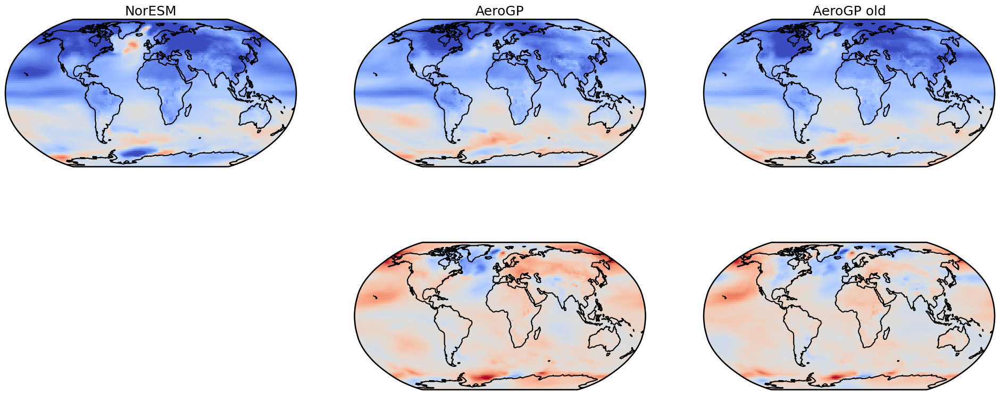

In [50]:
#eu back to 50, 150 inducing points, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP5 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-174212.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean5 = histaer_AeroGP5['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean5.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean5 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

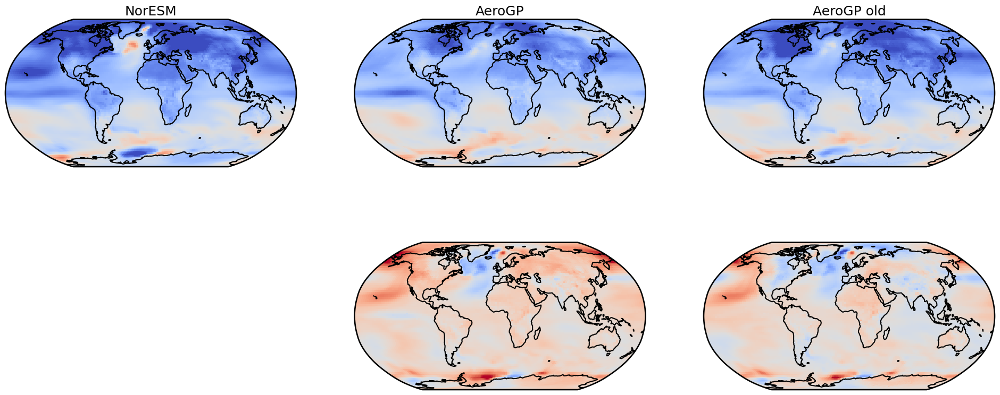

In [52]:
#eu back to 50, 100 inducing points, Matern12 kernels, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP6 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250225-205940.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean6 = histaer_AeroGP6['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean6.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean6 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

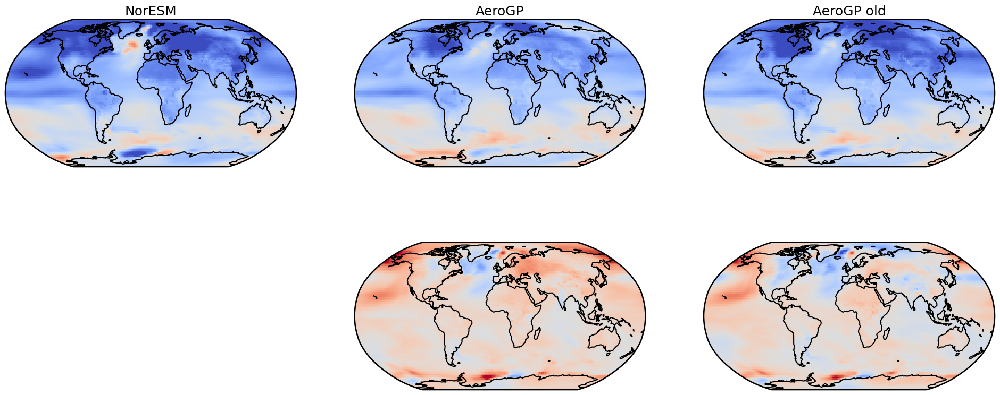

In [57]:
#eu back to 50, 100 inducing points, Matern12 kernel OC, Mater32 SO2 and BC, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP7 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250226-144608.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean7 = histaer_AeroGP7['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean7.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean7 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

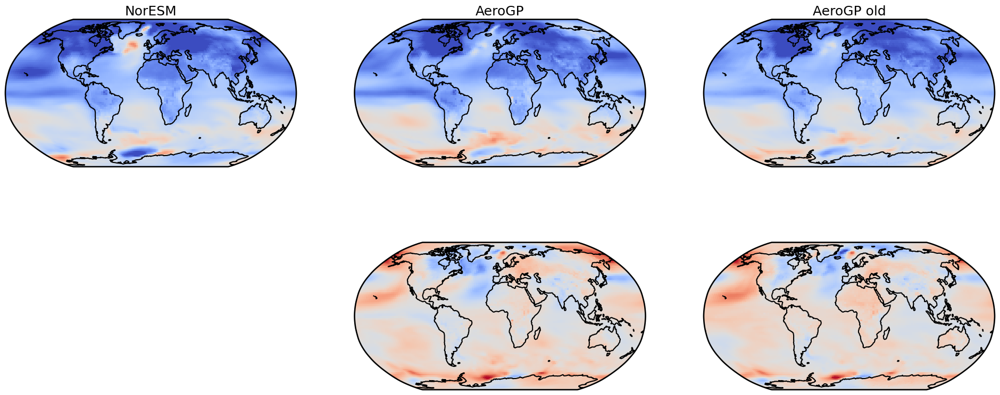

In [13]:
#eu 50, 100 inducing points, Mater32 all, Variance to 0.8, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP8 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250226-151807.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean8 = histaer_AeroGP8['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean8.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean8 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

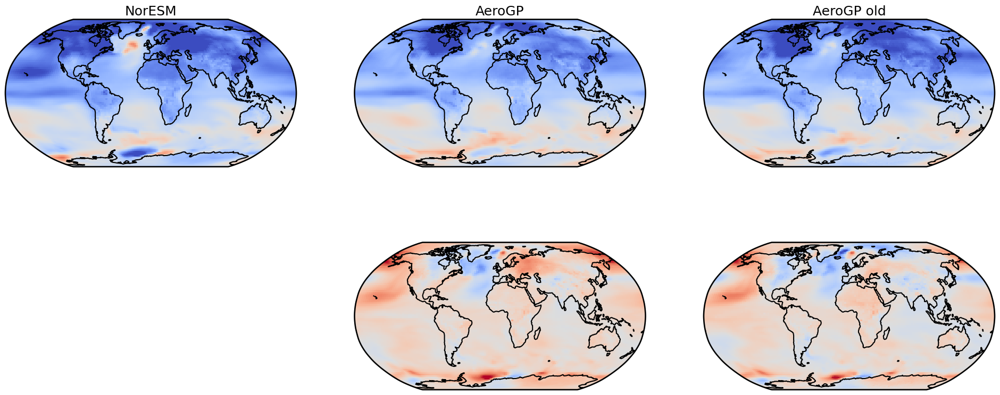

In [9]:
#eu 50, 100 inducing points, Mater32 all, Variance to 1.0, using V2 training data folder, new region definitions in making input dataframe:

histaer_NorESM = xr.open_dataset('../training_data_v3/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP9 = xr.open_dataset('../logs/logs_histaer/posterior_predictY_hist-aer_20250304-101932.nc')

histaer_NorESM_mean = histaer_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_mean9 = histaer_AeroGP9['posterior'].isel(year=slice(-20,None)).mean('year')
histaer_AeroGP_old_mean = histaer_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm2 = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    histaer_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    histaer_AeroGP_mean9.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    histaer_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (histaer_AeroGP_mean9 - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (histaer_AeroGP_old_mean - histaer_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm2, add_colorbar=False)
    plt.gca().coastlines()

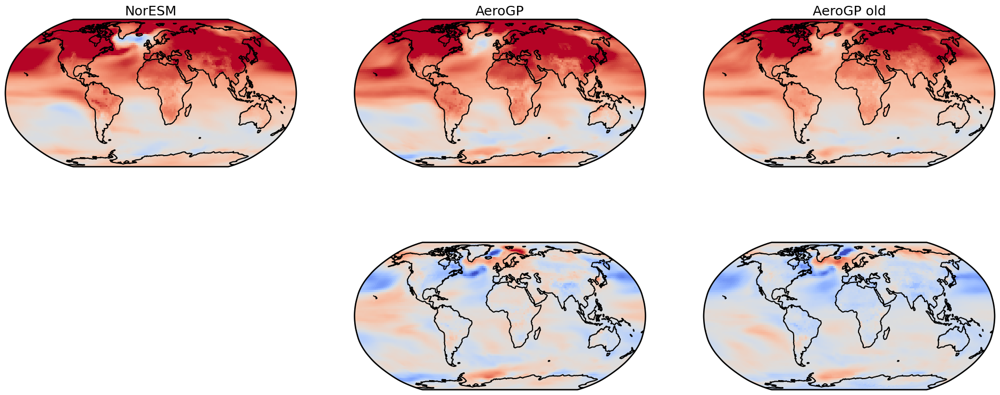

In [16]:
#eu 50, 100 inducing points, Mater32 all, Variance to 0.8, using V2 training data folder, new region definitions in making input dataframe:
#RAMIP

ramip_NorESM = xr.open_dataset('../training_data_v3/outputs_ramip_t1.nc')
ramip_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')
ramip_AeroGP8 = xr.open_dataset('../logs/logs_RAMIP T1/posterior_predictY_ramip_t1_20250226-195830.nc')

ramip_NorESM_mean = ramip_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
ramip_AeroGP_mean8 = ramip_AeroGP8['posterior'].isel(year=slice(-20,None)).mean('year')
ramip_AeroGP_old_mean = ramip_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm1 = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    ramip_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    ramip_AeroGP_mean8.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    ramip_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (ramip_AeroGP_mean8 - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (ramip_AeroGP_old_mean - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

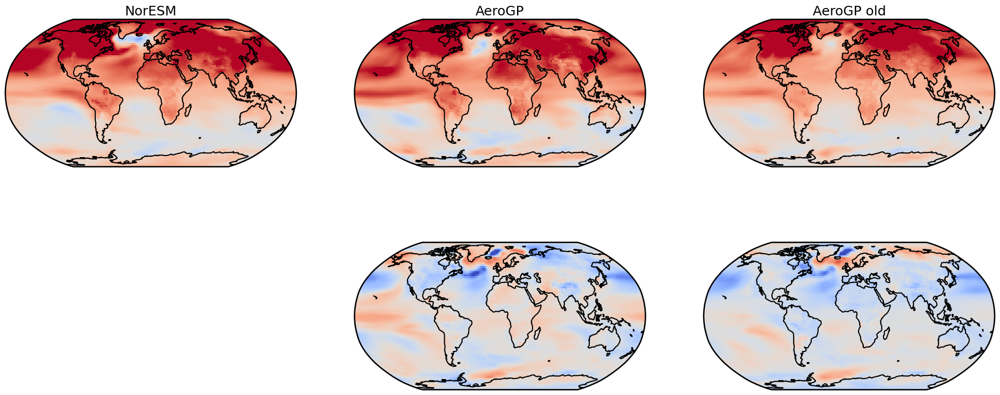

In [17]:
#eu 50, 100 inducing points, Mater32 all, Variance to 1.0, using V2 training data folder, new region definitions in making input dataframe:
#RAMIP

ramip_NorESM = xr.open_dataset('../training_data_v3/outputs_ramip_t1.nc')
ramip_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')
ramip_AeroGP9 = xr.open_dataset('../logs/logs_RAMIP T1/posterior_predictY_ramip_t1_20250226-210126.nc')

ramip_NorESM_mean = ramip_NorESM['tas_diff'].isel(year=slice(-20,None)).mean('year')
ramip_AeroGP_mean9 = ramip_AeroGP9['posterior'].isel(year=slice(-20,None)).mean('year')
ramip_AeroGP_old_mean = ramip_AeroGP_old['posterior'].isel(year=slice(-20,None)).mean('year')

divnorm1 = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    ramip_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    ramip_AeroGP_mean9.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    ramip_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (ramip_AeroGP_mean9 - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (ramip_AeroGP_old_mean - ramip_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

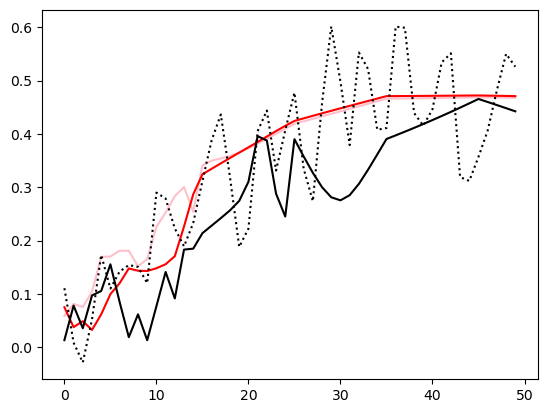

In [18]:

plt.plot(lat_weighted_mean(ramip_AeroGP8['posterior']),color='pink')
plt.plot(lat_weighted_mean(ramip_AeroGP9['posterior']),color='r')
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(ramip_AeroGP_old['posterior']),color='black')


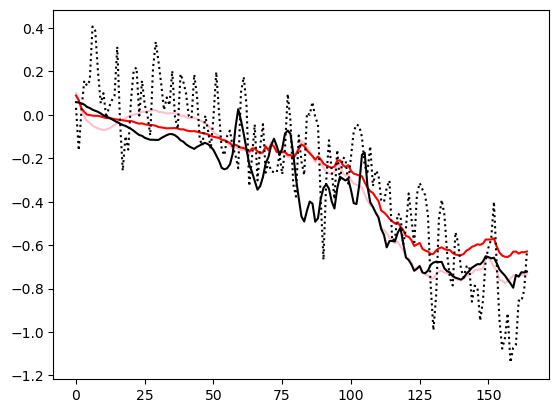

In [14]:
#plt.plot(lat_weighted_mean(histaer_AeroGP['posterior']),color='pink')
#plt.plot(lat_weighted_mean(histaer_AeroGP2['posterior']), color='pink')
#plt.plot(lat_weighted_mean(histaer_AeroGP3['posterior']), color='purple')
#plt.plot(lat_weighted_mean(histaer_AeroGP4['posterior']), color='orange')
#plt.plot(lat_weighted_mean(histaer_AeroGP5['posterior']), color='green')
#plt.plot(lat_weighted_mean(histaer_AeroGP6['posterior']), color='blue')
#plt.plot(lat_weighted_mean(histaer_AeroGP7['posterior']), color='cyan')
plt.plot(lat_weighted_mean(histaer_AeroGP8['posterior']), color='pink')
plt.plot(lat_weighted_mean(histaer_AeroGP9['posterior']), color='r')
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(histaer_AeroGP_old['posterior']),color='k')

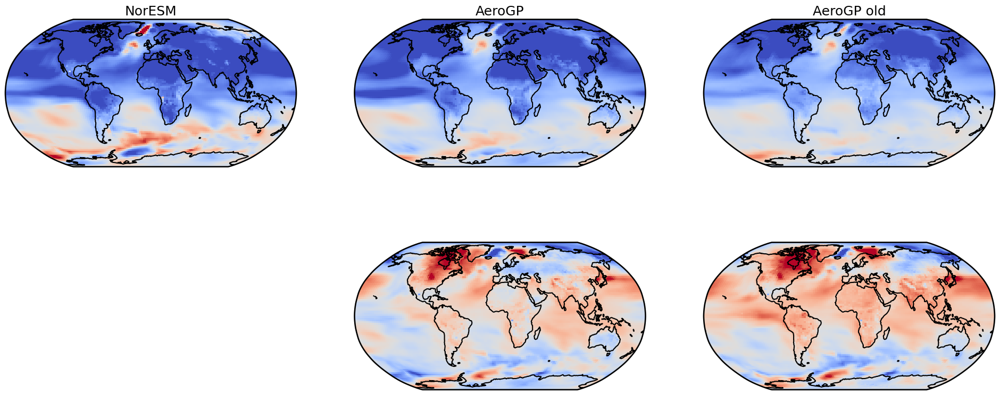

In [21]:
#ssp245-aer

ssp245_NorESM = xr.open_dataset('../training_data_v2/outputs_ssp245-aer.nc')
ssp245_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_ssp245-aer/posterior_predictY_ssp245-aer.nc')
ssp245_AeroGP = xr.open_dataset('../logs/logs_ssp245-aer/posterior_predictY_ssp245-aer_20250304-110103.nc')

ssp245_NorESM_mean = ssp245_NorESM['tas_diff'].isel(year=slice(0,20)).mean('year')
ssp245_AeroGP_mean = ssp245_AeroGP['posterior'].isel(year=slice(0,20)).mean('year')
ssp245_AeroGP_old_mean = ssp245_AeroGP_old['posterior'].isel(year=slice(0,20)).mean('year')

divnorm1 = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)

proj = ccrs.Robinson()

with sns.plotting_context("talk"):
        ## Truth
    fig = plt.figure(figsize=(24, 10))
 
    plt.subplot(231, projection=proj)
    ssp245_NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='NorESM')

    # Emulator
    plt.subplot(232, projection=proj)
    ssp245_AeroGP_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP')

    # Emulator old
    plt.subplot(233, projection=proj)
    ssp245_AeroGP_old_mean.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()
    plt.setp(plt.gca(), title='AeroGP old')

    # Differences
    plt.subplot(235, projection=proj)
    (ssp245_AeroGP_mean - ssp245_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

    plt.subplot(236, projection=proj)
    (ssp245_AeroGP_old_mean - ssp245_NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm1, add_colorbar=False)
    plt.gca().coastlines()

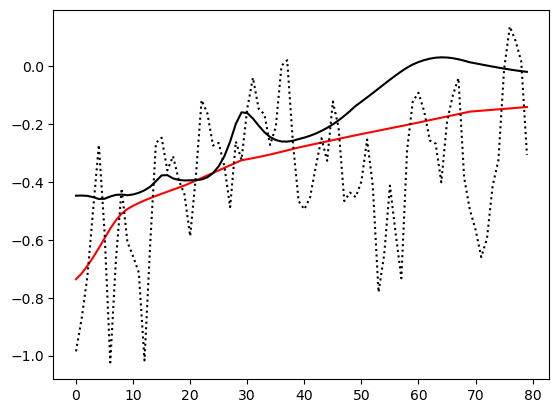

In [20]:
plt.plot(lat_weighted_mean(ssp245_AeroGP['posterior']), color='r')
plt.plot(lat_weighted_mean(ssp245_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(ssp245_AeroGP_old['posterior']),color='k')

In [5]:
# more noise kernel testing:

histaer_wk = xr.open_dataset('../logs/logs_hist-aer/logs_hist-aer_whitekerneldimstest/posterior_predictY_hist-aer_20250311-225506.nc')
histaer_wk2 = xr.open_dataset('../logs/logs_hist-aer/logs_hist-aer_whitekerneldimstest/posterior_predictY_hist-aer_20250312-002852.nc')
histaer_NorESM = xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_current = xr.open_dataset('../logs/logs_hist-aer/posterior_predictY_hist-aer_20250226-151807.nc')

In [6]:
histaer_3latent = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250314-164657.nc')

In [7]:
histaer_Pvar = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250314-174630.nc')

In [8]:
histaer_2latent = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250314-190341.nc')

In [9]:
histaer_3latent_8var = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250315-092708.nc')

In [10]:
histaer_v3 = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250315-122039.nc')

In [27]:
old_regions = xr.open_dataset('../logs/logs_hist-aer/sensitivity_test/posterior_predictY_hist-aer_oldregions.nc')
old_reg_v3 = xr.open_dataset('../logs/logs_hist-aer/sensitivity_test/posterior_predictY_hist-aer_oldregions_v3data.nc')

In [31]:
rbf_3latent = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250315-180700.nc')

In [33]:
newregions=xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250315-183946.nc')

In [38]:
newregions_1latent = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250315-190335.nc')

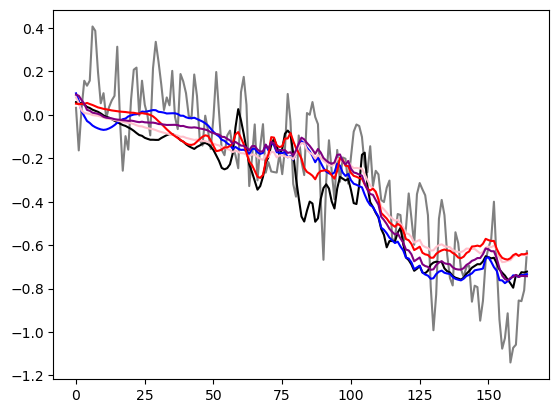

In [40]:
#plt.plot(lat_weighted_mean(histaer_wk['posterior']), color='r')
#plt.plot(lat_weighted_mean(histaer_wk2['posterior']), color='pink')
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']), color='grey')
plt.plot(lat_weighted_mean(histaer_AeroGP_old['posterior']), color='k')
#plt.plot(lat_weighted_mean(histaer_3latent['posterior']), color='g')
plt.plot(lat_weighted_mean(histaer_current['posterior']), color='b')
#plt.plot(lat_weighted_mean(histaer_Pvar['posterior']), color='cyan')
#plt.plot(lat_weighted_mean(histaer_2latent['posterior']), color='purple')
#plt.plot(lat_weighted_mean(histaer_3latent_8var['posterior']), color='orange')
plt.plot(lat_weighted_mean(histaer_v3['posterior']), color='pink')
plt.plot(lat_weighted_mean(old_regions['posterior']), color='r')
#plt.plot(lat_weighted_mean(old_reg_v3['posterior']), color='cyan')
#plt.plot(lat_weighted_mean(newregions['posterior']), color='orange')
plt.plot(lat_weighted_mean(newregions_1latent['posterior']), color='purple')

In [3]:
#function for plotting maps:

def plot_map_comp(NorESM_mean, AeroGP_mean1, AeroGP_mean2):
    divnorm = colors.TwoSlopeNorm(vmin=-2., vcenter=0., vmax=2.)

    proj = ccrs.Robinson()

    with sns.plotting_context("talk"):
            
        fig = plt.figure(figsize=(24, 10))
        ## Truth
        plt.subplot(231, projection=proj)
        NorESM_mean.plot(transform=ccrs.PlateCarree(central_longitude=0.0),cmap="coolwarm", norm=divnorm, add_colorbar=False)
        plt.gca().coastlines()
        plt.setp(plt.gca(), title='NorESM')

        # Emulator
        plt.subplot(232, projection=proj)
        AeroGP_mean1.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm, add_colorbar=False)
        plt.gca().coastlines()
        plt.setp(plt.gca(), title='AeroGP 1')

        # Emulator 2
        plt.subplot(233, projection=proj)
        AeroGP_mean2.plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm, add_colorbar=False)
        plt.gca().coastlines()
        plt.setp(plt.gca(), title='AeroGP 2')

        # Differences
        plt.subplot(235, projection=proj)
        (AeroGP_mean1 - NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm, add_colorbar=False)
        plt.gca().coastlines()

        plt.subplot(236, projection=proj)
        (AeroGP_mean2 - NorESM_mean).plot(transform=ccrs.PlateCarree(), cmap="coolwarm", norm=divnorm)
        plt.gca().coastlines()

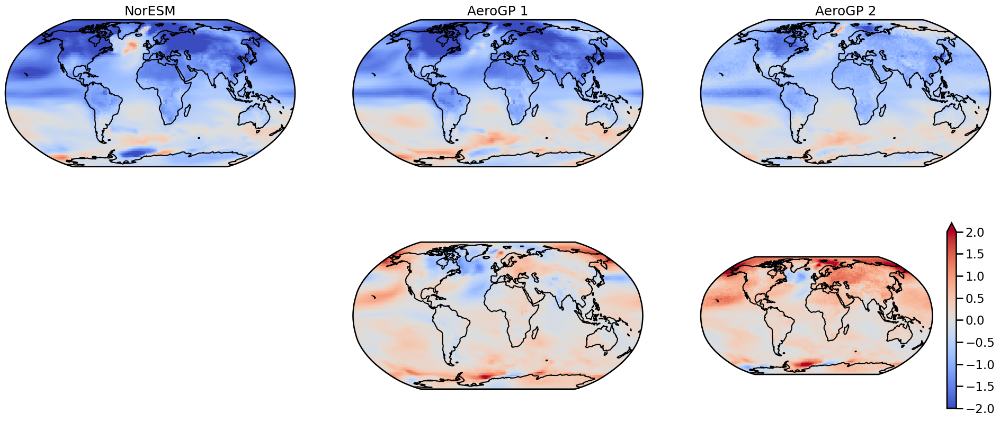

In [35]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), newregions['posterior'].sel(year=slice(1995,2014)).mean('year'))

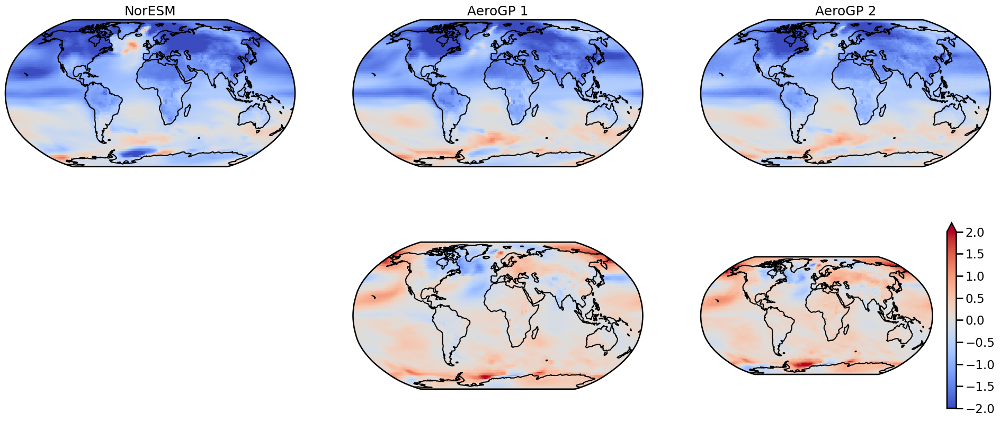

In [17]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), old_regions['posterior'].sel(year=slice(1995,2014)).mean('year'))

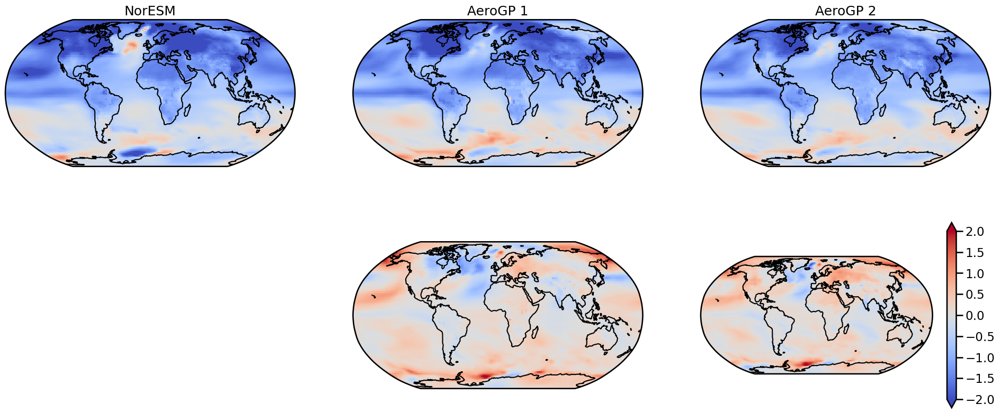

In [30]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_3latent['posterior'].sel(year=slice(1995,2014)).mean('year'))

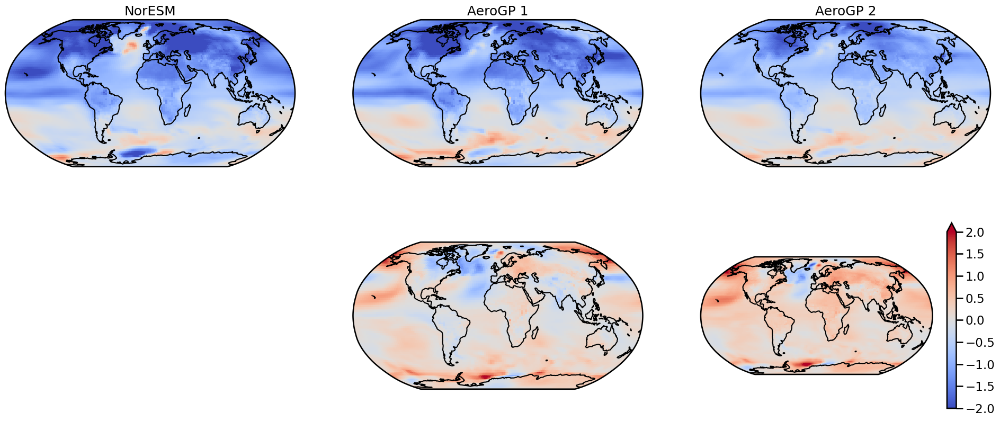

In [33]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_Pvar['posterior'].sel(year=slice(1995,2014)).mean('year'))

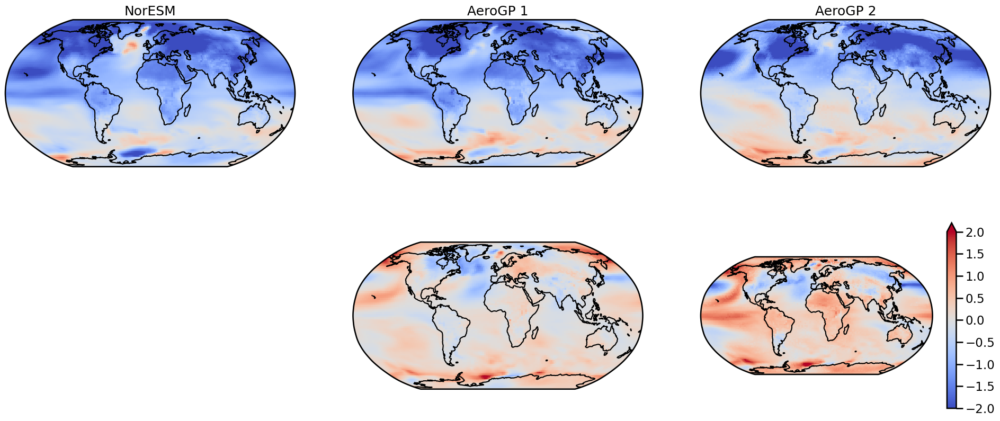

In [36]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_2latent['posterior'].sel(year=slice(1995,2014)).mean('year'))

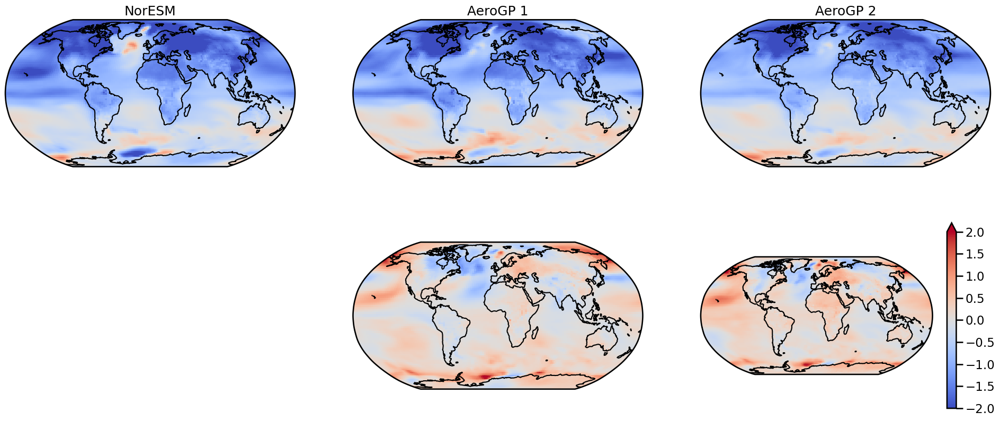

In [43]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_v3['posterior'].sel(year=slice(1995,2014)).mean('year'))

In [35]:
multi_var_test = xr.open_dataset('../logs/testing/RAMIP T1_multivar/posterior_predictY_ramip_t1_20250326_multivar.nc')
current_ramip = xr.open_dataset('../logs/lr_1lin/RAMIP T1/posterior_predictY_ramip_t1_20250324-200737.nc')
ramip_NorESM = xr.open_dataset('../training_data_v2/outputs_ramip_t1.nc')

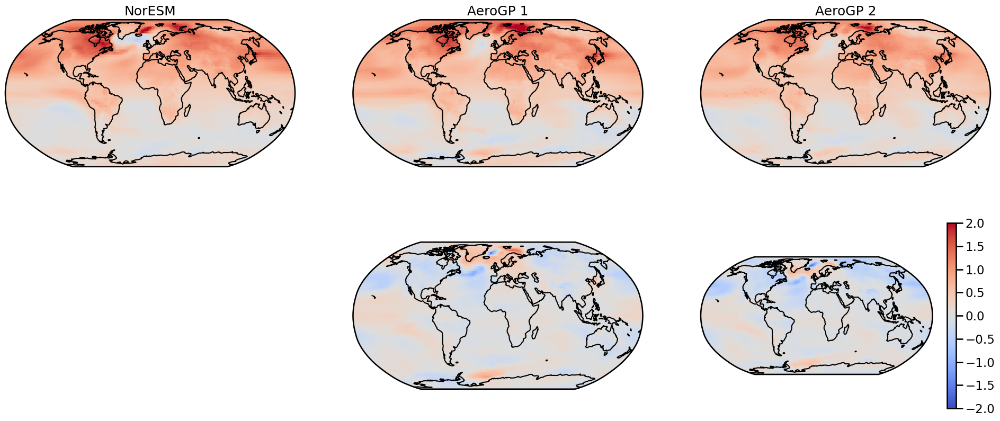

In [26]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), multi_var_test['posterior'].sel(year=slice(2045,2064)).mean('year'))

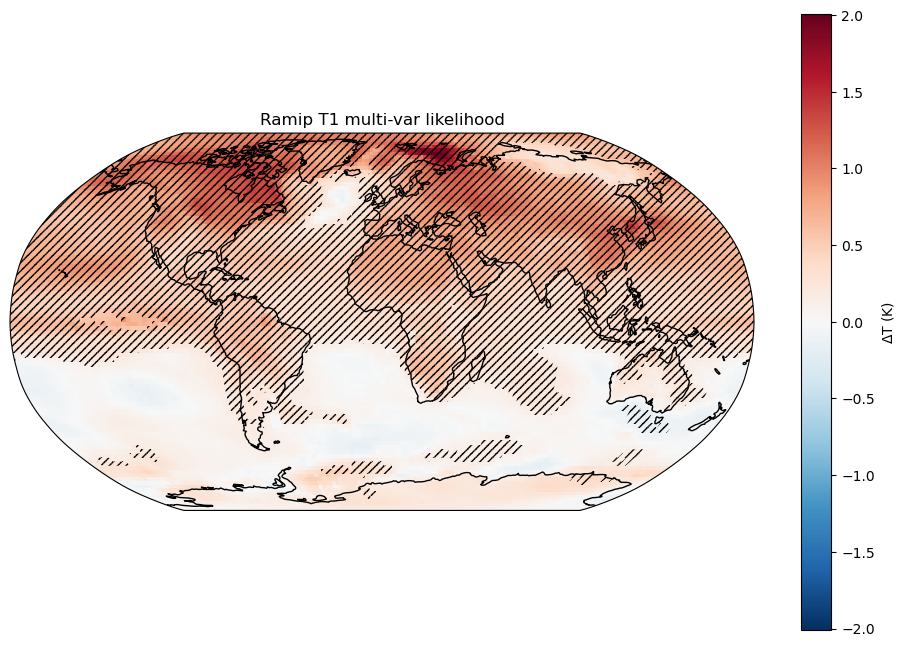

In [45]:
fig = plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
year_slice = slice(2045,2064)
multi_var_test['posterior'].sel(year=year_slice).mean('year', skipna=True).plot(ax=ax, transform=ccrs.PlateCarree(), cbar_kwargs={'label': "$\Delta$T (K)"})
ax.set_title('Ramip T1 multi-var likelihood')
plt.pcolor(multi_var_test['posterior'].lon, multi_var_test['posterior'].lat, (multi_var_test['posterior'].where(np.abs(multi_var_test['posterior']) > 0.5*multi_var_test['posterior std'])).sel(year=year_slice).mean('year', skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)

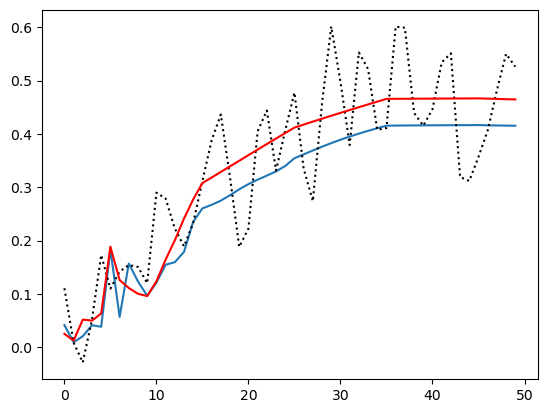

In [36]:
plt.plot(lat_weighted_mean(multi_var_test['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')

In [34]:
print(f"RMSE at 2045-2064: {get_rmse(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'),current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'))}")

RMSE at 2045-2064: 0.17325481974511156


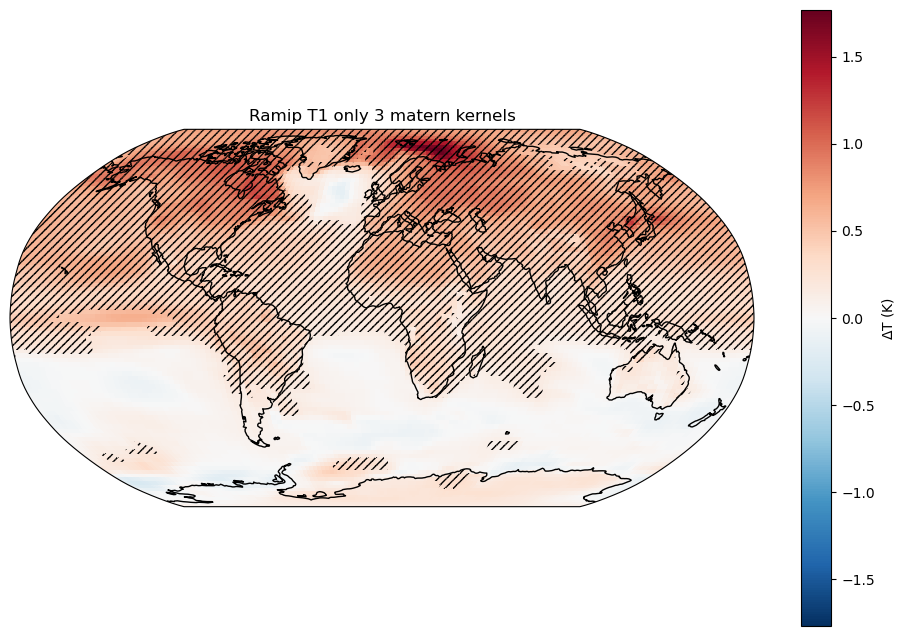

In [38]:
only_matern = xr.open_dataset('../logs/only_matern/RAMIP T1/posterior_predictY_ramip_t1_20250326-141216.nc')
fig = plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
year_slice = slice(2045,2064)
only_matern['posterior'].sel(year=year_slice).mean('year', skipna=True).plot(ax=ax, transform=ccrs.PlateCarree(), cbar_kwargs={'label': "$\Delta$T (K)"})
ax.set_title('Ramip T1 only 3 matern kernels')
plt.pcolor(only_matern['posterior'].lon, only_matern['posterior'].lat, (only_matern['posterior'].where(np.abs(only_matern['posterior']) > 0.5*only_matern['posterior std'])).sel(year=year_slice).mean('year', skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)

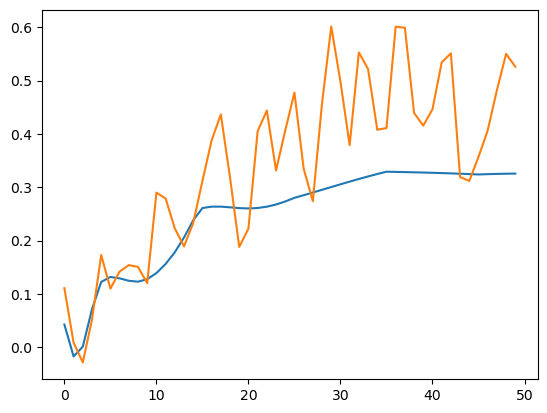

In [39]:
plt.plot(lat_weighted_mean(only_matern['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']))

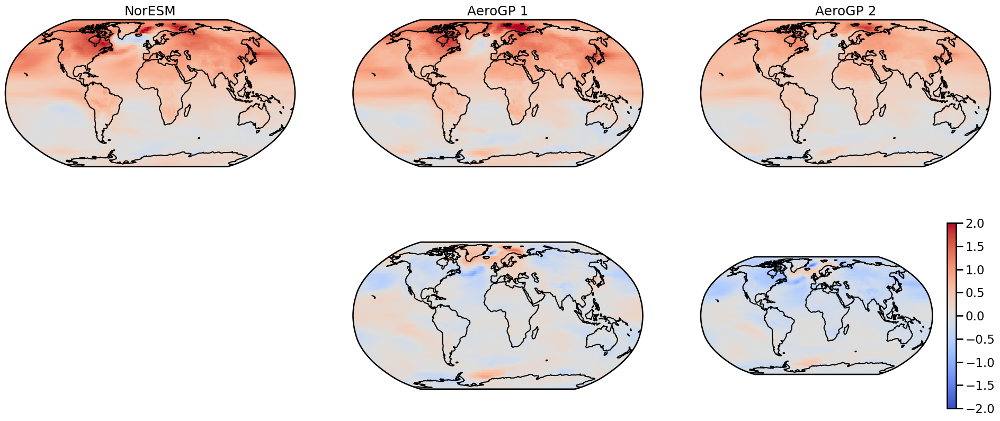

In [40]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), only_matern['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [5]:
regional_latent = xr.open_dataset('../logs/testing/regional_latent/RAMIP T1/posterior_predictY_ramip_t1_20250326-161027.nc')

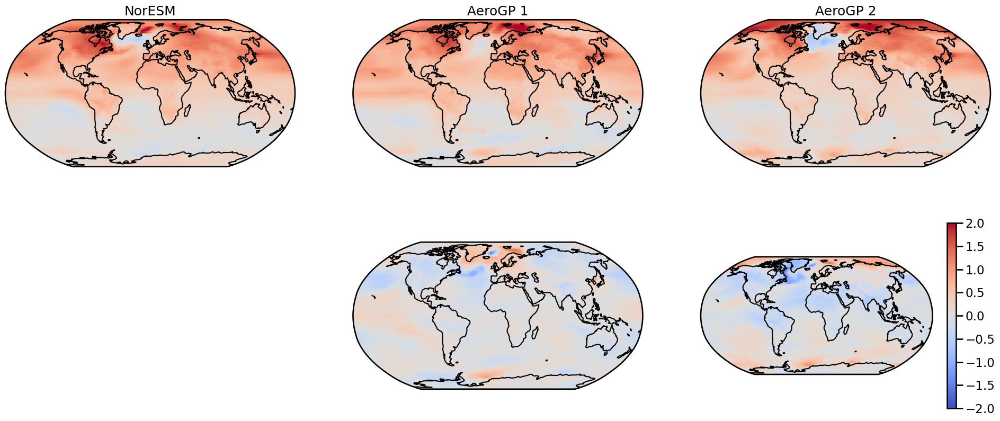

In [7]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), regional_latent['posterior'].sel(year=slice(2045,2064)).mean('year'))

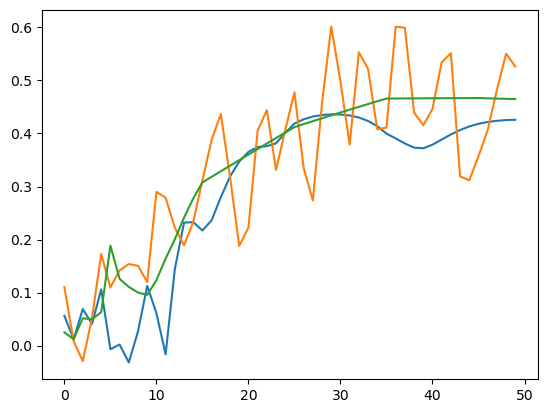

In [9]:
plt.plot(lat_weighted_mean(regional_latent['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']))
plt.plot(lat_weighted_mean(current_ramip['posterior']))

In [ ]:
def get_nrmse(truth, pred):
    weights = np.cos(np.deg2rad(truth.lat))
    return np.sqrt(((truth - pred)**2).weighted(weights).mean(['lat', 'lon'])).data / np.abs(truth.weighted(weights).mean(['lat','lon']).data)

RMSE at 2050-2059: 0.26688845041686665


In [14]:
get_nrmse(ramip_NorESM['tas_diff'].sel(year=slice(2035,2054)).mean('year'),regional_latent['posterior'].sel(year=slice(2035,2054)).mean('year'))

0.5006516243965913

In [18]:

def get_rmse(truth, pred):
    weights = np.cos(np.deg2rad(truth.lat))
    return np.sqrt(((truth - pred)**2).weighted(weights).mean(['lat', 'lon'])).data


# Compute RMSEs
print(f"RMSE at 2050-2059: {get_rmse(ramip_NorESM['tas_diff'].sel(year=slice(2050,2059)).mean('year'), regional_latent['posterior'].sel(year=slice(2050,2059)).mean('year'))}")

RMSE at 2050-2059: 0.26688845041686665


In [19]:
regional_latent_actdims = xr.open_dataset('../logs/testing/regional_latent/regional_latent_actdims/posterior_predictY_ramip_t1_20250326-173755.nc')

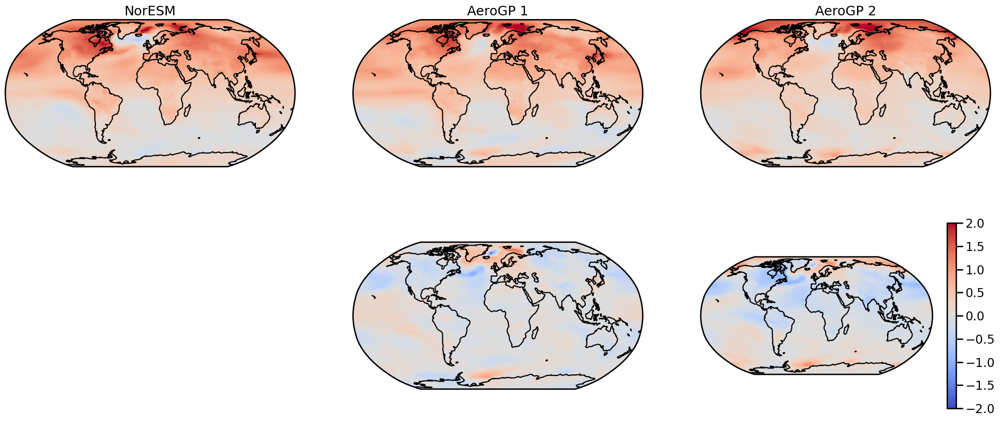

In [20]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), regional_latent_actdims['posterior'].sel(year=slice(2045,2064)).mean('year'))

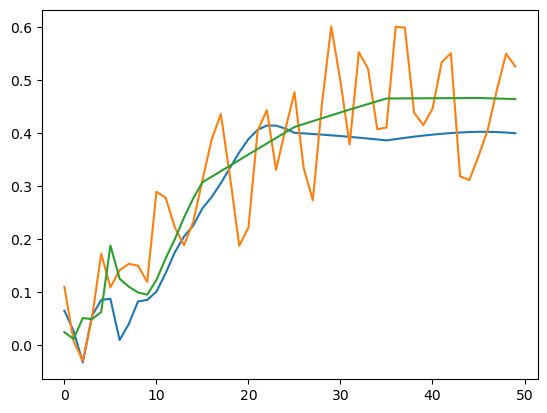

In [22]:
plt.plot(lat_weighted_mean(regional_latent_actdims['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']))
plt.plot(lat_weighted_mean(current_ramip['posterior']))

In [23]:

# Compute RMSEs
print(f"RMSE at 2050-2059: {get_rmse(ramip_NorESM['tas_diff'].sel(year=slice(2050,2059)).mean('year'), regional_latent_actdims['posterior'].sel(year=slice(2050,2059)).mean('year'))}")

RMSE at 2050-2059: 0.26808092976965664


In [37]:
histaer_multivar = xr.open_dataset('../logs/testing/hist-aer multivar/posterior_predictY_hist-aer_20250326-182858.nc')
histaer_NorESM = xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')
histaer_current = xr.open_dataset('../logs/lr_1lin/hist-aer/posterior_predictY_hist-aer_20250324-193235.nc')

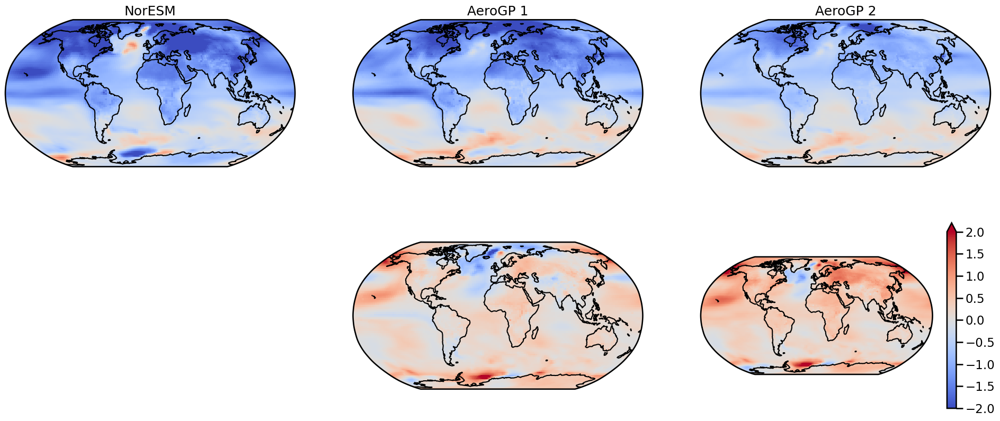

In [38]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_multivar['posterior'].sel(year=slice(1995,2014)).mean('year'))

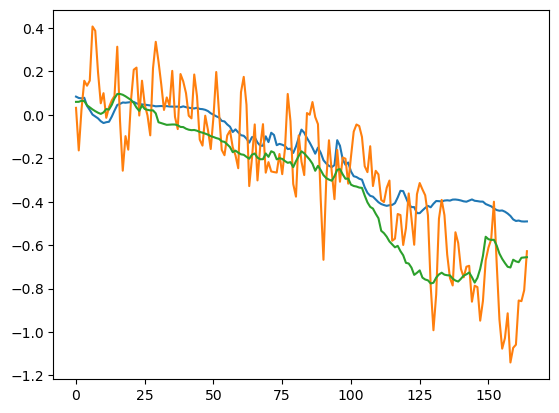

In [39]:
plt.plot(lat_weighted_mean(histaer_multivar['posterior']))
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']))
plt.plot(lat_weighted_mean(histaer_current['posterior']))

In [47]:
old_naonly = xr.open_dataset('../logs/testing/old_naregion_only/posterior_predictY_ramip_t1_20250326-215453.nc')
ramip_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')

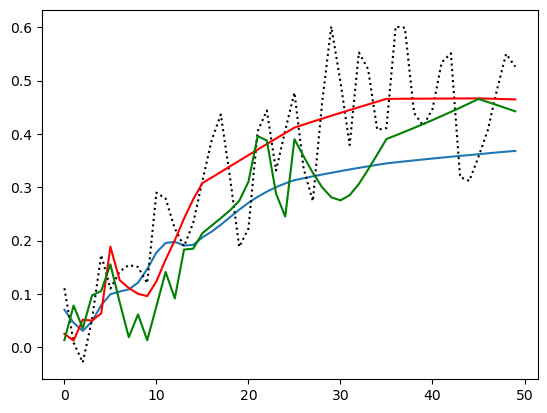

In [48]:
plt.plot(lat_weighted_mean(old_naonly['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')
plt.plot(lat_weighted_mean(ramip_old['posterior']), color='g')

Text(0.5, 1.0, 'Ramip T1 only linear and 1 matern for NA')

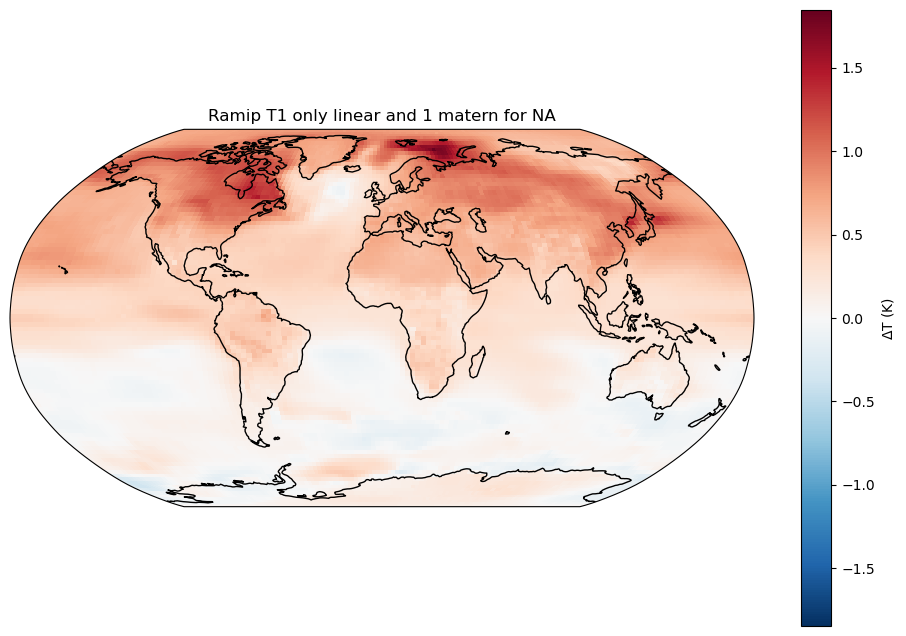

In [49]:
fig = plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
year_slice = slice(2045,2064)
old_naonly['posterior'].sel(year=year_slice).mean('year', skipna=True).plot(ax=ax, transform=ccrs.PlateCarree(), cbar_kwargs={'label': "$\Delta$T (K)"})
ax.set_title('Ramip T1 only linear and 1 matern for NA')
#plt.pcolor(only_matern['posterior'].lon, only_matern['posterior'].lat, (only_matern['posterior'].where(np.abs(only_matern['posterior']) > 0.5*only_matern['posterior std'])).sel(year=year_slice).mean('year', skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)

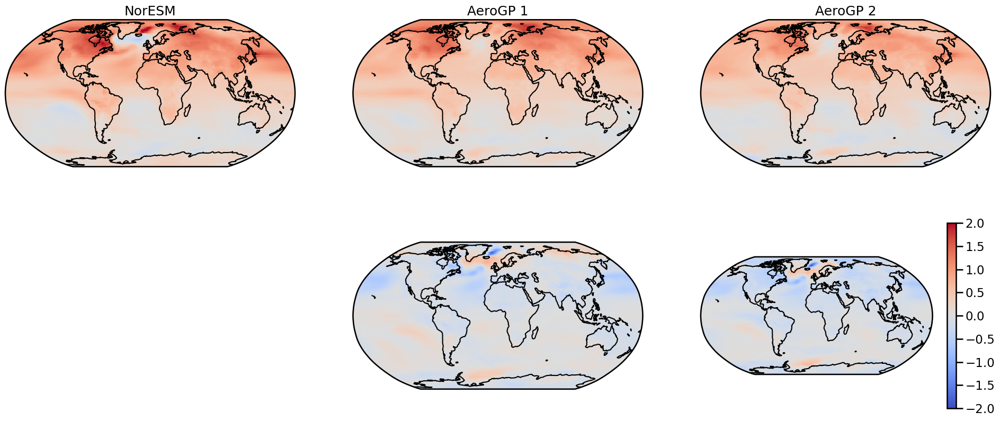

In [50]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), ramip_old['posterior'].sel(year=slice(2045,2064)).mean('year'), old_naonly['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [59]:
alloldregions = xr.open_dataset('../logs/testing/old_regions/posterior_predictY_ramip_t1_20250326-232207.nc')
v2oldregions = xr.open_dataset('../logs/testing/old_regions/v2folder/posterior_predictY_ramip_t1_20250327-000049.nc')


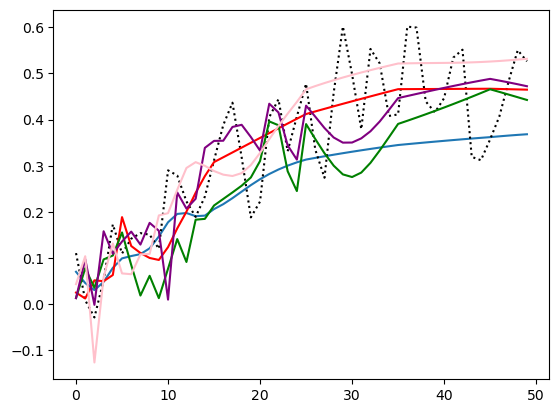

In [60]:
plt.plot(lat_weighted_mean(old_naonly['posterior']))
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')
plt.plot(lat_weighted_mean(ramip_old['posterior']), color='g')
plt.plot(lat_weighted_mean(alloldregions['posterior']), color='purple')
plt.plot(lat_weighted_mean(v2oldregions['posterior']), color='pink')

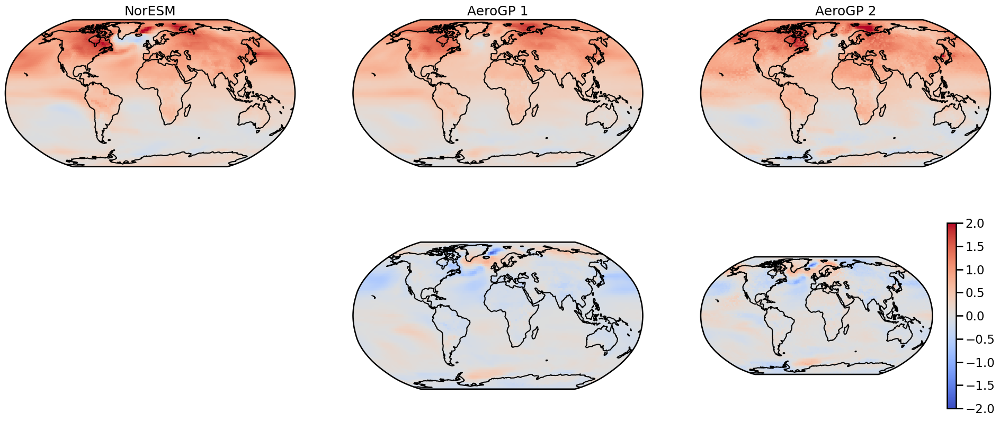

In [53]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), ramip_old['posterior'].sel(year=slice(2045,2064)).mean('year'), alloldregions['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [61]:
latent8 = xr.open_dataset('../logs/testing/8latent//posterior_predictY_ramip_t1_20250327-082544.nc')


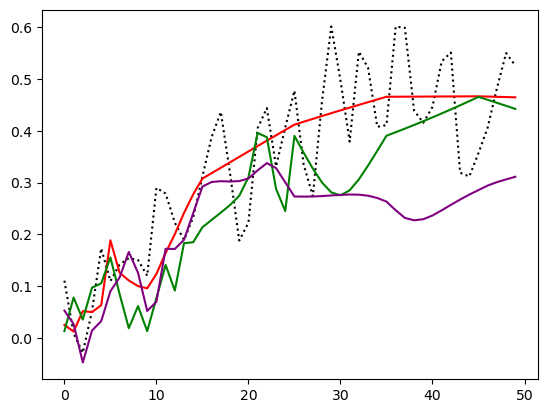

In [62]:
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')
plt.plot(lat_weighted_mean(ramip_old['posterior']), color='g')
plt.plot(lat_weighted_mean(latent8['posterior']), color='purple')


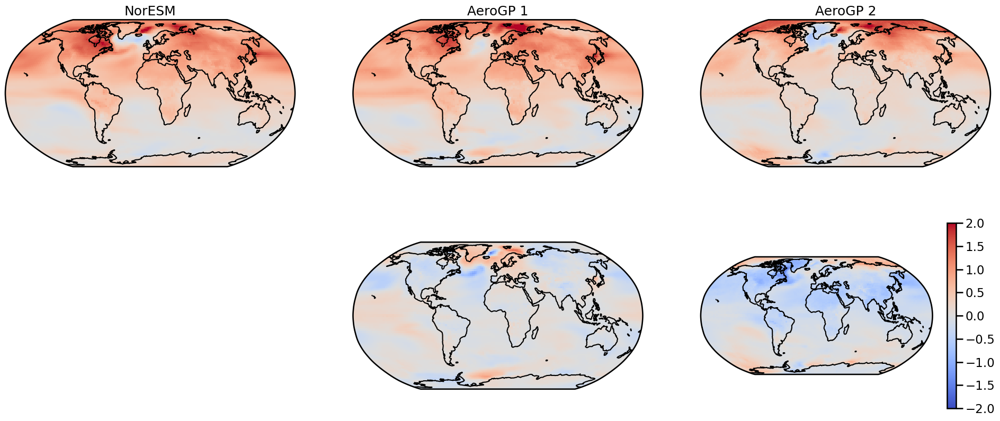

In [64]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), latent8['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [65]:
latentv3 = xr.open_dataset('../logs/testing/8latentv3//posterior_predictY_ramip_t1_20250327-093618.nc')

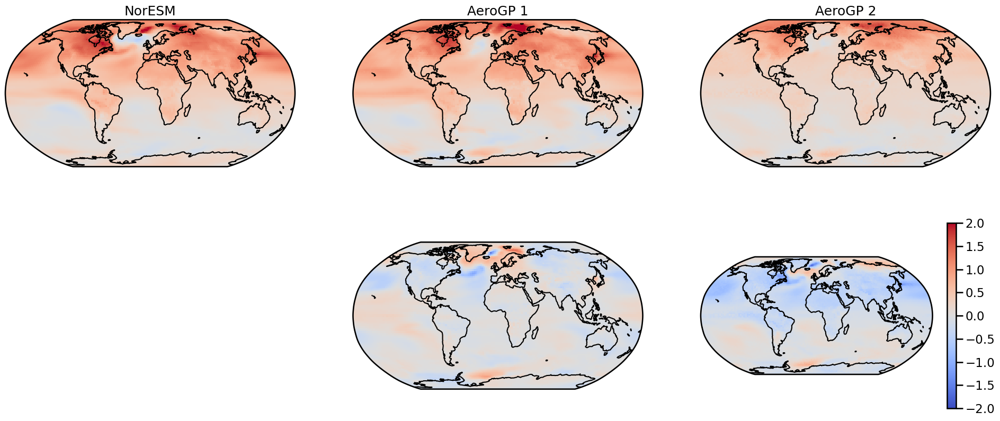

In [66]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), latentv3['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [67]:
currentv3=xr.open_dataset('../logs/testing/l1_1lin_v3//posterior_predictY_ramip_t1_20250327-101108.nc')

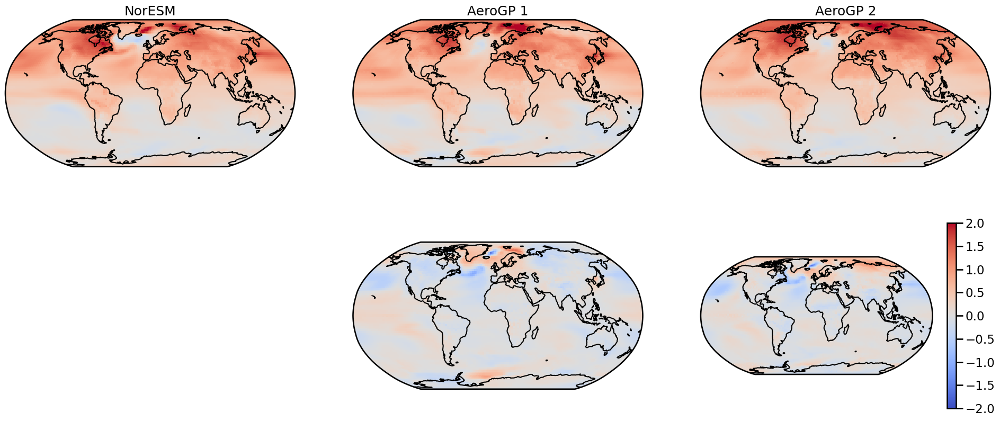

In [68]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), currentv3['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [70]:
get_rmse(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), currentv3['posterior'].sel(year=slice(2045,2064)).mean('year'))

array(0.18077244)

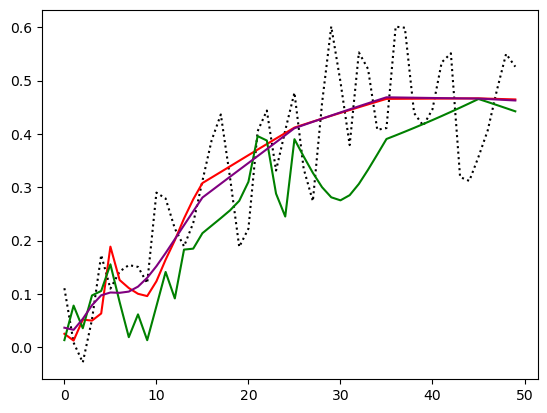

In [69]:
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')
plt.plot(lat_weighted_mean(ramip_old['posterior']), color='g')
plt.plot(lat_weighted_mean(currentv3['posterior']), color='purple')

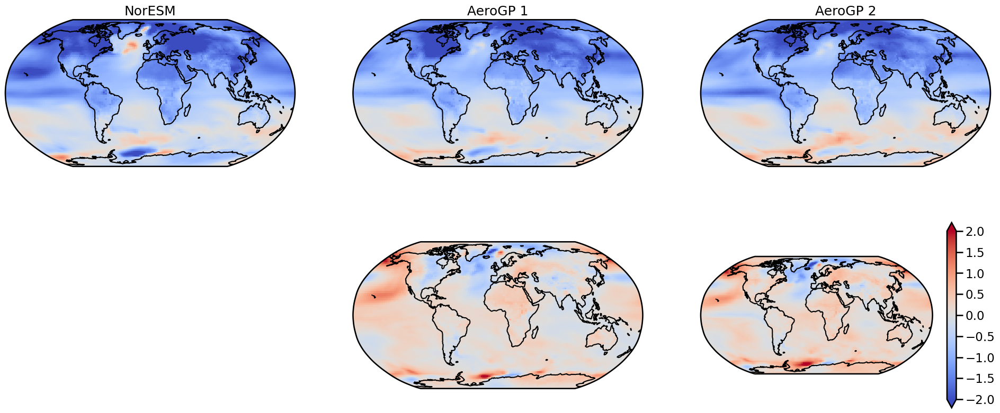

In [6]:
#Fixed regions, reduced number (6), 100 inducting points. March 2025 final version:

histaer_NorESM = xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_AeroGP_current = xr.open_dataset('../logs/lr_1lin/hist-aer/posterior_predictY_hist-aer_20250324-193235.nc')

plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_AeroGP_old['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_AeroGP_current['posterior'].sel(year=slice(1995,2014)).mean('year'))

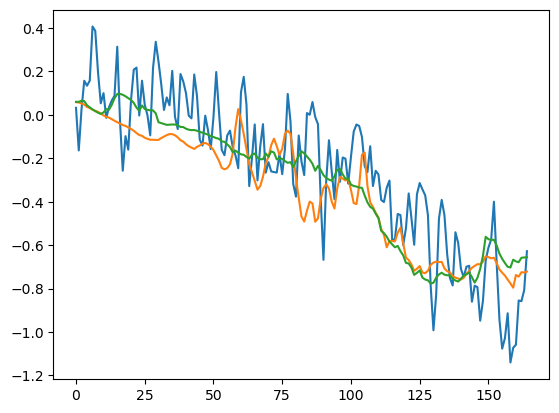

In [7]:
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']), label='NorESM')
plt.plot(lat_weighted_mean(histaer_AeroGP_old['posterior']), label='AeroGP old regions')
plt.plot(lat_weighted_mean(histaer_AeroGP_current['posterior']), label='AeroGP new regions (6)')



In [71]:
histaer_currentv3 = xr.open_dataset('../logs/testing/l1_1lin_v3/hist-aer/posterior_predictY_hist-aer_20250327-110709.nc')

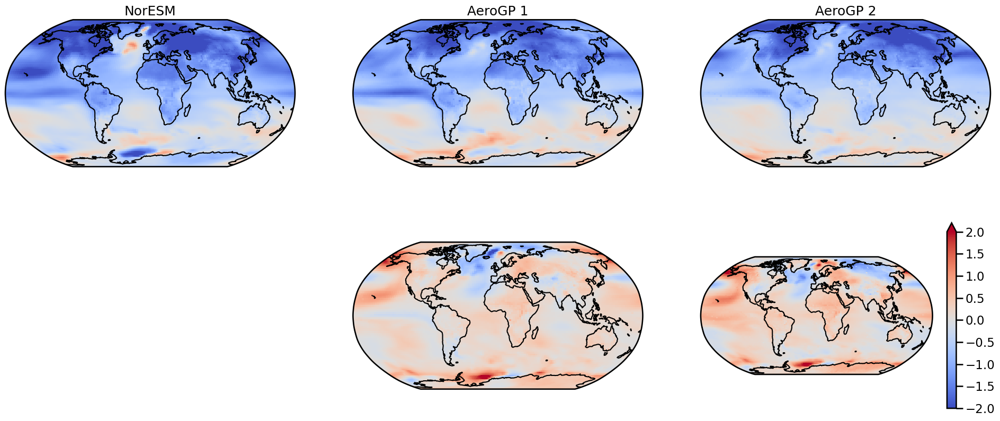

In [72]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_currentv3['posterior'].sel(year=slice(1995,2014)).mean('year'))

In [74]:
histaer_multivar = xr.open_dataset('../logs/testing/hist-aer multivar/posterior_predictY_hist-aer_20250327-115525.nc')

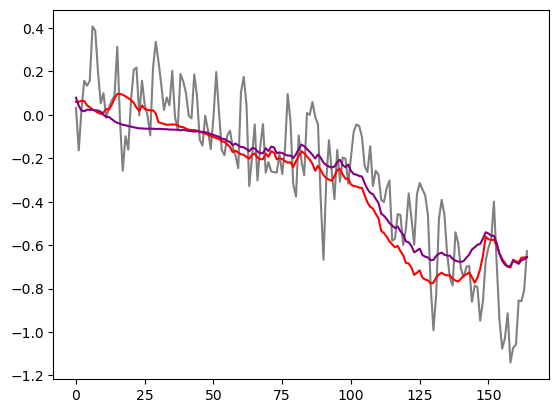

In [75]:
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']), color='grey')
plt.plot(lat_weighted_mean(histaer_current['posterior']), color='r')
plt.plot(lat_weighted_mean(histaer_multivar['posterior']), color='purple')

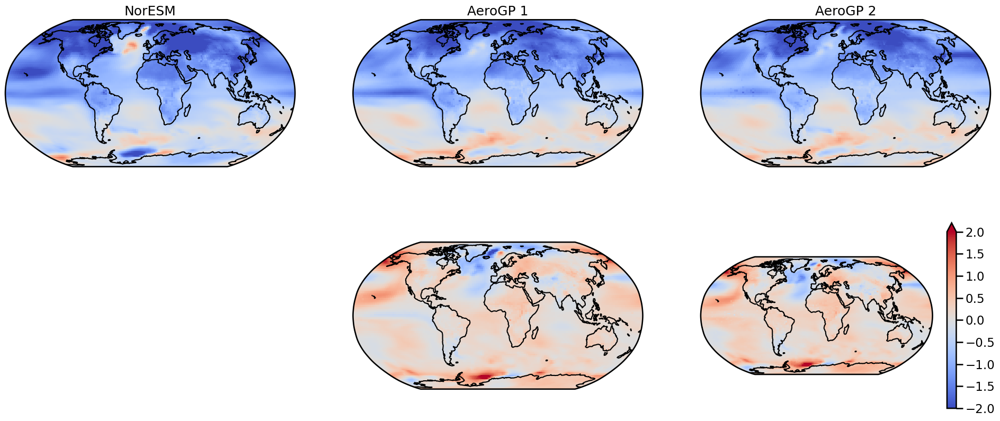

In [76]:
plot_map_comp(histaer_NorESM['tas_diff'].sel(year=slice(1995,2014)).mean('year'), histaer_current['posterior'].sel(year=slice(1995,2014)).mean('year'), histaer_multivar['posterior'].sel(year=slice(1995,2014)).mean('year'))

In [ ]:
#only 2000 iterations though...
latent7 = xr.open_dataset('../logs/testing/latent7_multivar/posterior_predictY_ramip_t1_20250327-180208.nc')

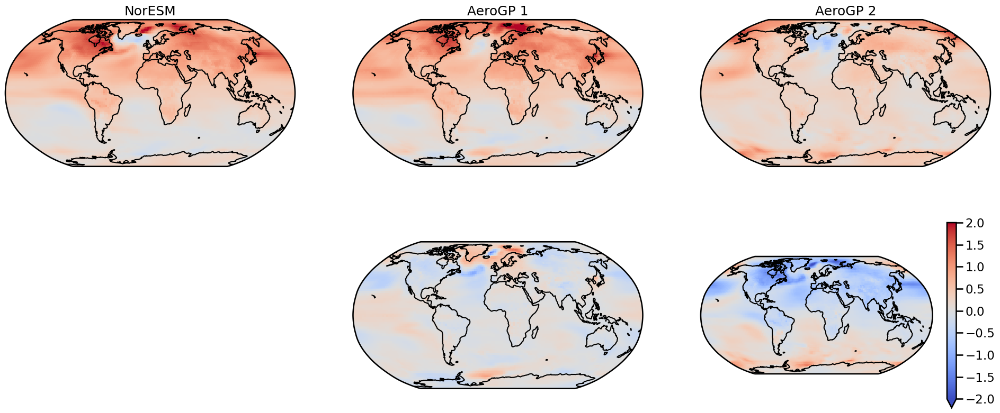

In [81]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), latent7['posterior'].sel(year=slice(2045,2064)).mean('year'))

In [82]:
#4000 iterations, 7 latent functions with ARD, variance for each output:
latent7_multivar = xr.open_dataset('../logs/testing/latent7_multivar/ard/posterior_predictY_ramip_t1_20250327-182936.nc')

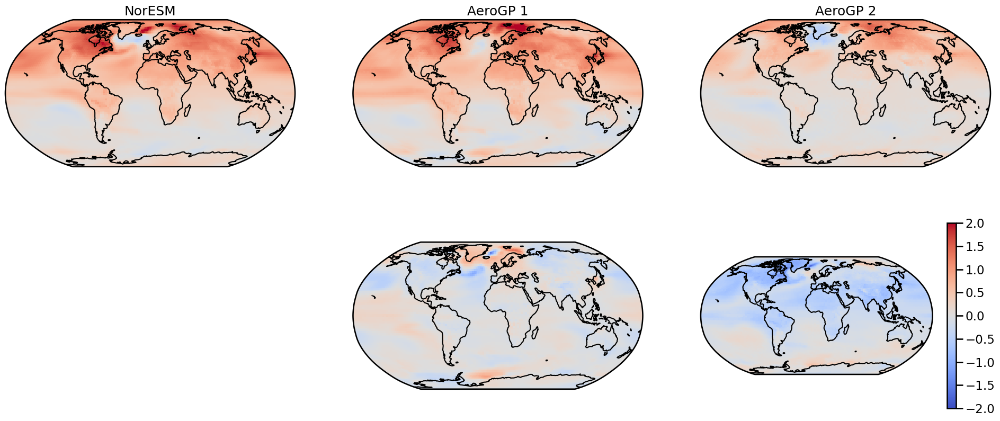

In [83]:
plot_map_comp(ramip_NorESM['tas_diff'].sel(year=slice(2045,2064)).mean('year'), current_ramip['posterior'].sel(year=slice(2045,2064)).mean('year'), latent7_multivar['posterior'].sel(year=slice(2045,2064)).mean('year'))

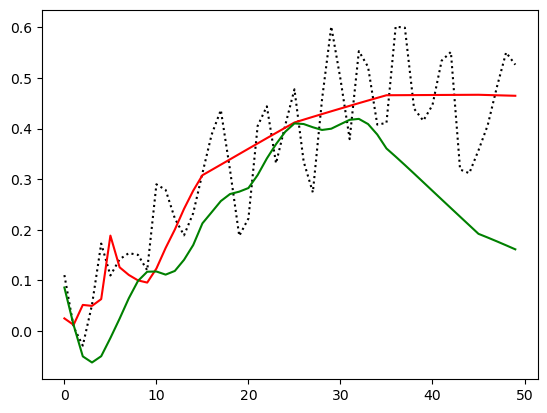

In [84]:
plt.plot(lat_weighted_mean(ramip_NorESM['tas_diff']), linestyle=':',color='k')
plt.plot(lat_weighted_mean(current_ramip['posterior']), color='r')
plt.plot(lat_weighted_mean(latent7['posterior']), color='g')

In [96]:
ramip_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')

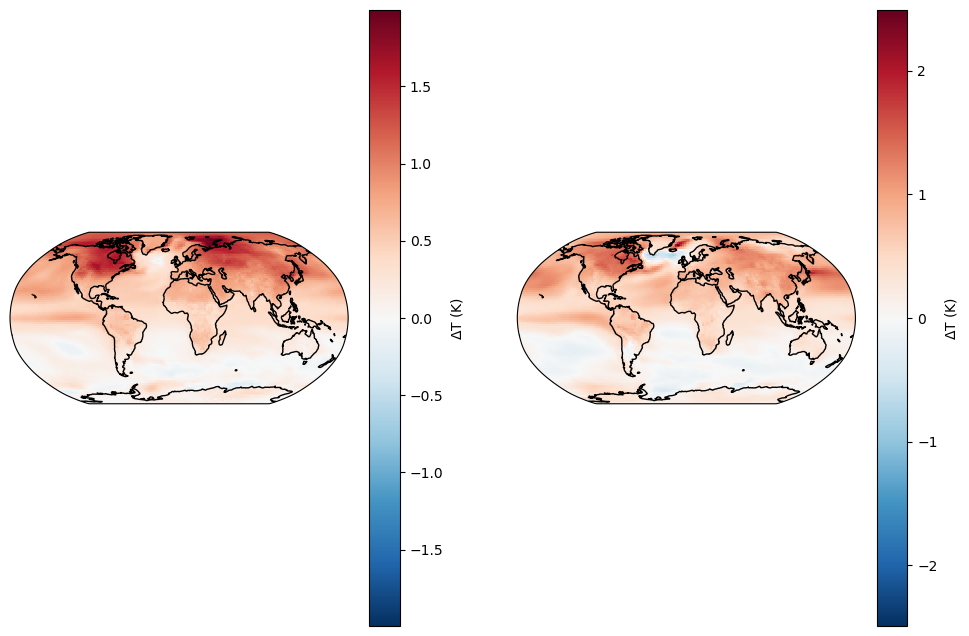

In [102]:
fig,axs = plt.subplots(1,2,figsize=(12, 8), subplot_kw={'projection': ccrs.Robinson()})
axs[0].coastlines()
year_slice = slice(2055,2065)
ramip_AeroGP_old['posterior'].sel(year=year_slice).mean('year', skipna=True).plot(ax=axs[0], transform=ccrs.PlateCarree(), cbar_kwargs={'label': "$\Delta$T (K)"})
axs[1].coastlines()
ramip_NorESM['tas_diff'].sel(year=year_slice).mean('year', skipna=True).plot(ax=axs[1], transform=ccrs.PlateCarree(), cbar_kwargs={'label': "$\Delta$T (K)"})

In [41]:
jan_recreation = xr.open_dataset('../logs/logs_hist-aer/recreate_Jan/posterior_predictY_hist-aer_20250315-194138.nc')

In [47]:
jan_recreation2 = xr.open_dataset('../logs/logs_hist-aer/recreate_Jan/posterior_predictY_hist-aer_20250315-200118.nc')
jan_recreation3 = xr.open_dataset('../logs/logs_hist-aer/recreate_Jan/posterior_predictY_hist-aer_20250315-203856.nc')

In [51]:
reload_test = xr.open_dataset('../logs/posterior_predictY_hist-aer_20250316-101525.nc')

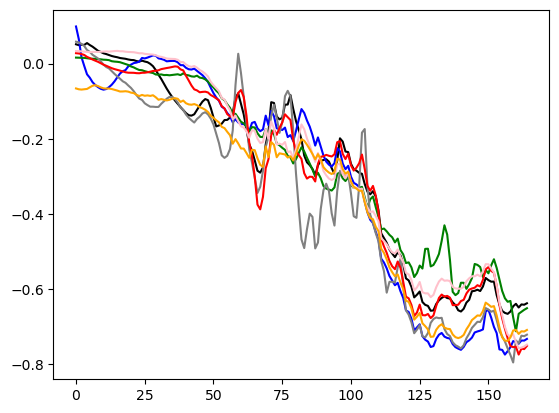

In [52]:
plt.plot(lat_weighted_mean(old_regions['posterior']), color='k')
plt.plot(lat_weighted_mean(histaer_current['posterior']), color='b')
plt.plot(lat_weighted_mean(jan_recreation['posterior']), color='g')
plt.plot(lat_weighted_mean(histaer_AeroGP_old['posterior']), color='grey')
plt.plot(lat_weighted_mean(jan_recreation2['posterior']), color='r')
plt.plot(lat_weighted_mean(jan_recreation3['posterior']), color='pink')
plt.plot(lat_weighted_mean(reload_test['posterior']), color='orange')

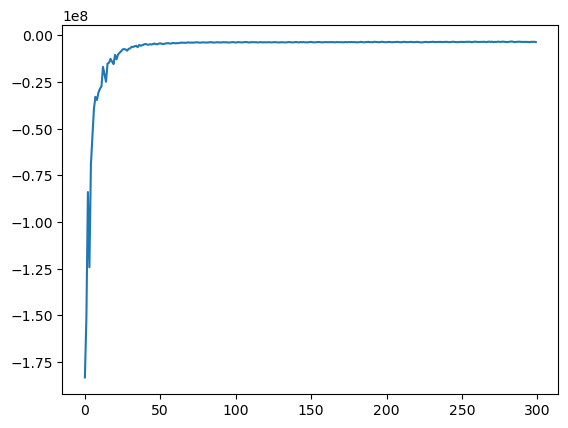

In [36]:
elbo = pd.read_csv('../logs/logs_hist-aer/latentfn_testing/elbo.csv')
plt.plot(elbo['elbo'])

In [3]:
histaer_NorESM = xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')
histaer_AeroGP_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_current = xr.open_dataset('../logs/logs_hist-aer/posterior_predictY_hist-aer_20250226-151807.nc')
reload_test = xr.open_dataset('../logs/posterior_predictY_hist-aer_20250316-105858.nc')


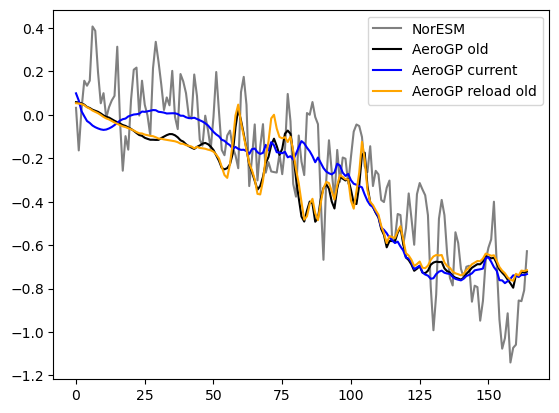

In [6]:
plt.plot(lat_weighted_mean(histaer_NorESM['tas_diff']), color='grey',label='NorESM')
plt.plot(lat_weighted_mean(histaer_AeroGP_old['posterior']), color='k',label='AeroGP old')
plt.plot(lat_weighted_mean(histaer_current['posterior']), color='b',label='AeroGP current')
plt.plot(lat_weighted_mean(reload_test['posterior']), color='orange',label='AeroGP reload old')
plt.legend()

In [64]:
pert_regions = dict([
    ('gb', [0, -90, 360, 90]),
    ('ru', [60, 45, 180, 80]),
    ('ea', [90, -10, 150, 45]),
    ('wa', [60, 0, 90, 45]),
    ('au', [105, -45, 165, -10]),
    ('na', [190, 15, 305, 78]),
    ('sa', [270, -60, 330, 15]),
    ('af', [-25, -40, 60, 37]),
    ('eu', [-20, 37, 50, 75]),
])


def create_predictor_regions(pert_regions, data_set):
    #for given input dataset and coordingates of regions, sum emissions in those regions and return as dataframe.
    #note: emission units are Tg/yr per gridbox (so summing over lat/lon gives Tg/yr for that region) (not fluxes!)
    inputs = pd.DataFrame()
    X = data_set

    #for EU and AF, which cross the maridian, we need to adjust the longitude range to be between -180 and 180
    #make a copy of the dataset and adjust the longitude values:
    X_mod = X.copy()
    X_mod['lon'] = np.mod(X_mod['lon'] + 180, 360) - 180
    X_mod = X_mod.sortby(X_mod.lon)

    for key_region in pert_regions:

        #set up lat/lon slice values:
        lat_slice = slice(pert_regions[key_region][1],pert_regions[key_region][3])
        lon_slice = slice(pert_regions[key_region][0],pert_regions[key_region][2])
        print(key_region, lon_slice)

        #select from modified dataset if region is 'eu' or 'af':
        if key_region == 'eu' or key_region == 'af':
            Y_SO2 = X_mod['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X_mod['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X_mod['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)
        
        else:       
            Y_SO2 = X['SO2'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('SO2')
            Y_SO2 = Y_SO2.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_SO2], axis=1)

            Y_BC = X['BC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('BC')
            Y_BC = Y_BC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_BC], axis=1)

            Y_OC = X['OC'].sel(lat=lat_slice,lon=lon_slice).sum(('lat','lon')).to_dataframe('OC')
            Y_OC = Y_OC.add_suffix(key_region)
            inputs = pd.concat([inputs, Y_OC], axis=1)

    return inputs

In [65]:
test_regions_hist = create_predictor_regions(pert_regions, xr.open_dataset('../training_data_v2/inputs_hist-aer.nc'))

gb slice(0, 360, None)
ru slice(60, 180, None)
ea slice(90, 150, None)
wa slice(60, 90, None)
au slice(105, 165, None)
na slice(190, 305, None)
sa slice(270, 330, None)
af slice(-25, 60, None)
eu slice(-20, 50, None)


<Axes: xlabel='year'>

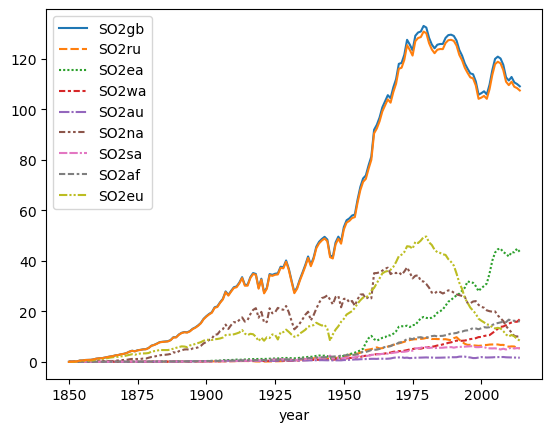

In [66]:
sns.lineplot(data=test_regions_hist.filter(like='SO2'))
sns.lineplot(data=test_regions_hist.filter(like='SO2').drop(columns='SO2gb').sum(axis=1))

In [51]:
xr.open_dataset('../training_data_v3/inputs_hist-aer.nc').sel(lon=slice(10-180,125-180))

<xarray.Dataset> Size: 2kB
Dimensions:  (year: 165, lat: 96, lon: 0)
Coordinates:
  * year     (year) int64 1kB 1850 1851 1852 1853 1854 ... 2011 2012 2013 2014
  * lat      (lat) float64 768B -90.0 -88.11 -86.21 -84.32 ... 86.21 88.11 90.0
  * lon      (lon) float64 0B 
Data variables:
    SO2      (year, lat, lon) float64 0B ...
    BC       (year, lat, lon) float64 0B ...
    OC       (year, lat, lon) float64 0B ...
Attributes:
    units:          Tg/yr
    experiment_id:  hist-aer

In [68]:
#check longitude values for all input datasets:
for ii in glob.glob('../training_data_v3/inputs_*.nc'):
    print(ii)
    print(xr.open_dataset(ii).coords['lon'].values.min())
    print(xr.open_dataset(ii).coords['lon'].values.max())

../training_data_v3\inputs_0xEA_SO2.nc
0.0
357.5
../training_data_v3\inputs_0xEU_SO2.nc
0.0
357.5
../training_data_v3\inputs_0xNA_SO2.nc
0.0
357.5
../training_data_v3\inputs_0xSA_SO2.nc
0.0
357.5
../training_data_v3\inputs_10xEU_BC.nc
0.0
357.5
../training_data_v3\inputs_10xNA_BC.nc
0.0
357.5
../training_data_v3\inputs_10xSA_BC.nc
0.0
357.5
../training_data_v3\inputs_10xSA_SO2.nc
0.0
357.5
../training_data_v3\inputs_5xEA_BC.nc
0.0
357.5
../training_data_v3\inputs_5xEA_SO2.nc
0.0
357.5
../training_data_v3\inputs_5xNA_SO2.nc
0.0
357.5
../training_data_v3\inputs_7xEU_SO2.nc
0.0
357.5
../training_data_v3\inputs_AeroGP1.nc
0.0
357.5
../training_data_v3\inputs_AeroGP2.nc
0.0
357.5
../training_data_v3\inputs_global_anthro_Ann.nc
0.0
357.5
../training_data_v3\inputs_global_BC_Ann.nc
0.0
357.5
../training_data_v3\inputs_global_OC_Ann.nc
0.0
357.5
../training_data_v3\inputs_global_SO2_Ann.nc
0.0
357.5
../training_data_v3\inputs_hist-aer.nc
0.0
357.5
../training_data_v3\inputs_ramip_af.nc
0.0
357

In [ ]:
multi_lin = xr.open_dataset('../logs/logs_hist-aer latentfn testing/posterior_predictY_hist-aer_20250318-102414.nc')
hist_aerfeb = xr.open_dataset('../logs/logs_hist-aer/posterior_predictY_hist-aer_20250226-151807.nc')
histaer_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_spitlatent = xr.open_dataset('../logs/logs_hist-aer/latentfn_testing/posterior_predictY_hist-aer_20250314-164657.nc')
histaer_minut = xr.open_dataset('../logs/logs_hist-aer min ut new regions/posterior_predictY_hist-aer_20250318-005545.nc')
#hist_2latent = xr.open_dataset('../logs/logs_hist-aer latentfn testing split/posterior_predictY_hist-aer_20250318-121941.nc')

In [ ]:
#plt.plot(lat_weighted_mean(xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')['tas_diff']), label='NorESM', color='grey', linestyle='--')
plt.plot(lat_weighted_mean(multi_lin['posterior']), label='multi_lin')
plt.plot(lat_weighted_mean(hist_aerfeb['posterior']), label='hist-aer Feb')
plt.plot(lat_weighted_mean(histaer_old['posterior']), label='hist-aer old')
plt.plot(lat_weighted_mean(histaer_spitlatent['posterior']), label='hist-aer spit latent 3 ways')
plt.plot(lat_weighted_mean(histaer_minut['posterior']), label='hist-aer minimal utils, old regions')
#plt.plot(lat_weighted_mean(hist_2latent['posterior']), label='hist-aer 2 latent')
plt.legend()

In [ ]:
plt.figure(figsize=(10,5))
fig, ax = plt.subplots(2,1, figsize=(10, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
multi_lin['posterior'].sel(year=slice(1995,2015)).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[0].pcolor(multi_lin.lon, multi_lin.lat, (multi_lin['posterior'].where(np.abs(multi_lin['posterior'])>0.5*multi_lin['posterior std'])).sel(year=slice(1995,2015)).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[0].coastlines()
ax[0].set_title('hist-aer mutli-lin')   

histaer_old['posterior'].sel(year=slice(1995,2015)).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[1].pcolor(histaer_old.lon, histaer_old.lat, (histaer_old['posterior'].where(np.abs(histaer_old['posterior'])>0.5*histaer_old['posterior std'])).sel(year=slice(1995,2015)).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[1].coastlines()
ax[1].set_title('hist-aer old')

In [ ]:
ramip_multilin = xr.open_dataset('../logs/logs_RAMIP T1 latentfn testing/posterior_predictY_ramip_t1_20250318-111609.nc')
ramip_feb = xr.open_dataset('../logs/logs_RAMIP T1/posterior_predictY_ramip_t1_20250226-195830.nc')
ramip_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP T1/posterior_predictY_ramip_t1.nc')

In [ ]:
plt.plot(lat_weighted_mean(xr.open_dataset('../training_data_v2/outputs_ramip_t1.nc')['tas_diff']), label='NorESM', color='grey', linestyle='--')
plt.plot(lat_weighted_mean(ramip_multilin['posterior']), label='multi_lin')
plt.plot(lat_weighted_mean(ramip_feb['posterior']), label='ramip feb')
plt.plot(lat_weighted_mean(ramip_old['posterior']), label='ramip old')
plt.legend()

In [ ]:
plt.figure(figsize=(10,5))
fig, ax = plt.subplots(2,1, figsize=(10, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
ramip_multilin['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[0].pcolor(ramip_multilin.lon, ramip_multilin.lat, (ramip_multilin['posterior'].where(np.abs(ramip_multilin['posterior'])>0.5*ramip_multilin['posterior std'])).sel(year=slice(2045,2065)).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[0].coastlines()
ax[0].set_title('ramip t1 mutli-lin')   

ramip_old['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), cmap="coolwarm", cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[1].pcolor(ramip_old.lon, ramip_old.lat, (ramip_old['posterior'].where(np.abs(ramip_old['posterior'])>0.5*ramip_old['posterior std'])).sel(year=slice(2045,2065)).mean('year',skipna=True), transform=ccrs.PlateCarree(), hatch='////', alpha=0)
ax[1].coastlines()
ax[1].set_title('ramip t1 old')

In [ ]:
histaer_minut = xr.open_dataset('../logs/logs_hist-aer min ut new regions/posterior_predictY_hist-aer_20250318-000719.nc')
hist_aerfeb = xr.open_dataset('../logs/logs_hist-aer/posterior_predictY_hist-aer_20250226-151807.nc')
histaer_old = xr.open_dataset('../logs/before pert_region fix/logs_hist-aer/posterior_predictY_hist-aer.nc')
histaer_recreateold = xr.open_dataset('../logs/logs_hist-aer min ut new regions/posterior_predictY_hist-aer_20250318-005545.nc')
histaer_newreg_100id = xr.open_dataset('../logs/logs_hist-aer min ut new regions/posterior_predictY_hist-aer_20250318-012606.nc')

In [ ]:
plt.plot(lat_weighted_mean(histaer_minut['posterior']).values, label='hist-aer min utils')
plt.plot(lat_weighted_mean(hist_aerfeb['posterior']).values, label='hist-aer feb')
plt.plot(lat_weighted_mean(histaer_old['posterior']).values, label='hist-aer old')
plt.plot(lat_weighted_mean(histaer_recreateold['posterior']).values, label='hist-aer recreate old')
plt.plot(lat_weighted_mean(histaer_newreg_100id['posterior']).values, label='hist-aer new reg 100 id')
plt.legend()

In [ ]:
plt.plot(lat_weighted_mean(hist_aer['posterior']), label='hist-aer')
plt.plot(lat_weighted_mean(hist_aer01['posterior']), label='hist-aer01')
plt.plot(lat_weighted_mean(hist_aer05['posterior']), label='hist-aer05')
plt.plot(lat_weighted_mean(hist_aer2['posterior']), label='hist-aer2')
#plt.plot(lat_weighted_mean(hist_aer05['posterior']*2), label='hist-aer05*2')
plt.plot(lat_weighted_mean(hist_aer['posterior']*2), label='hist-aer*2')
plt.plot(lat_weighted_mean(xr.open_dataset('../training_data_v2/outputs_hist-aer.nc')['tas_diff']), label='NorESM', color='grey', linestyle='--')
plt.legend()

In [ ]:
ramipea2_test = xr.open_dataset('../logs/logs_RAMIP EA testing/posterior_predictY_ramipEA2_20250317-132103.nc')
ramipea_test = xr.open_dataset('../logs/logs_RAMIP EA testing/posterior_predictY_ramip_ea_20250317-123144.nc')
ramipea_4000 = xr.open_dataset('../logs/logs_RAMIP EA testing MAXITER 4000/posterior_predictY_ramip_ea_20250317-140055.nc')
ramipea_3000 = xr.open_dataset('../logs/logs_RAMIP EA testing MAXITER 3000/posterior_predictY_ramip_ea_20250317-142129.nc')
ramipea_natfirst = xr.open_dataset('../logs/logs_RAMIP EA testing natgrad first/posterior_predictY_ramip_ea_20250317-144640.nc')
ramipea_gamma = xr.open_dataset('../logs/logs_RAMIP EA testing gamma 0.5/posterior_predictY_ramip_ea_20250317-153325.nc')
ramipea_old = xr.open_dataset('../logs/before pert_region fix/logs_RAMIP EA/posterior_predictY_ramip_ea.nc')
ramipea_regions = xr.open_dataset('../logs/logs_RAMIP EA region testing/posterior_predictY_ramip_ea_20250317-155852.nc')
ramipea_redo_old = xr.open_dataset('../logs/logs_RAMIP EA old regions/posterior_predictY_ramip_ea_20250317-164219.nc')
ramipea_loadold = xr.open_dataset('../logs/logs_RAMIP EA old regions/posterior_predictY_ramip_ea_20250317-164334.nc')
another_redo = xr.open_dataset('../logs/logs_RAMIP EA old recreated MAXITER 4000 works/posterior_predictY_ramip_ea_20250317-173030.nc')
redo_exp = xr.open_dataset('../logs/logs_RAMIP EA minimal utils/posterior_predictY_ramip_ea_20250317-225535.nc')

In [ ]:
ramipea_AeroGP = xr.open_dataset('../logs/logs_RAMIP EA/posterior_predictY_ramip_ea_20250305-043748.nc')
ramipea01_AeroGP = xr.open_dataset('../logs/logs_RAMIP EA/sensitivity_test/posterior_predictY_ramipEA01_20250311-211946.nc')
ramipea05_AeroGP = xr.open_dataset('../logs/logs_RAMIP EA/sensitivity_test/posterior_predictY_ramipEA05_20250311-212003.nc')
ramipea2_AeroGP = xr.open_dataset('../logs/logs_RAMIP EA/sensitivity_test/posterior_predictY_ramipEA2_20250311-212022.nc')


In [ ]:
plt.plot(lat_weighted_mean(ramipea_test['posterior']), label='ramip-ea march 17')
#plt.plot(lat_weighted_mean(ramipea2_test['posterior']), label='ramip-ea2 march 17')
#plt.plot(lat_weighted_mean(ramipea_4000['posterior']), label='ramip-ea 4000')
plt.plot(lat_weighted_mean(xr.open_dataset('../training_data_v2/outputs_ramip_ea.nc')['tas_diff']), label='NorESM', color='grey', linestyle='--')
#plt.plot(lat_weighted_mean(ramipea_3000['posterior']), label='ramip-ea 3000')
#plt.plot(lat_weighted_mean(ramipea_natfirst['posterior']), label='ramip-ea natgrad first')
#plt.plot(lat_weighted_mean(ramipea_gamma['posterior']), label='ramip-ea gamma 0.5')
plt.plot(lat_weighted_mean(ramipea_old['posterior']), label='ramip-ea old')
plt.plot(lat_weighted_mean(ramipea_regions['posterior']), label='ramip-ea regions')
#plt.plot(lat_weighted_mean(ramipea_redo_old['posterior']), label='ramip-ea redo old')
#plt.plot(lat_weighted_mean(ramipea_loadold['posterior']), label='ramip-ea reload old')
plt.plot(lat_weighted_mean(another_redo['posterior']), label='ramip-ea another redo')
plt.plot(lat_weighted_mean(redo_exp['posterior']), label='ramip-ea long exp utils')
plt.plot(lat_weighted_mean(new_regions['posterior']), label='ramip-ea new regions')
plt.legend()

In [ ]:
plt.figure(figsize=(10,5))
fig, ax = plt.subplots(1,3, figsize=(15, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
ramipea_oldtest_v3['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), norm=norms, cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
#plt.pcolor(eu10bc2_robust.lon, eu10bc2_robust.lat, eu10bc2_robust, hatch='///', alpha=0., transform=ccrs.PlateCarree())
ax[0].coastlines()
ax[0].set_title('v3')

ramipea_oldtest_v2['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), norm=norms, cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
#plt.pcolor(ramipea_oldtest_v2.lon, ramipea_oldtest_v2.lat, ramipea_oldtest_v2['posterior'].sel(year=slice(2045,2065)).mean('year').where(ramipea_oldtest_v2['posterior'].sel(year=slice(2045,2065)).mean('year')>0.5*ramipea_oldtest_v2['posterior std'].sel(year=slice(2045,2065)).mean('year')), hatch='///', alpha=0., transform=ccrs.PlateCarree())
ax[1].coastlines()
ax[1].set_title('v2')

(0.5*ramipea_oldtest_v2['posterior std'].sel(year=slice(2045,2065)).mean('year')).plot(ax=ax[2],transform=ccrs.PlateCarree(), cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[2].coastlines()
ax[2].set_title('0.5* v2 std')

#so first loading old model but with new region definitions in the utils_GP.py file. Then testing with v2 and v3 folders in config file, even though the inputs are the same,
#the outputs are different. Not sure what in the model setup is changing? Also re-loading with v3 folder didn't change again, so its not the order.


In [ ]:
ew_regions = xr.open_dataset('../logs/logs_RAMIP EA testing/posterior_predictY_ramip_ea_20250316-185731.nc')
new_regions_mean = new_regions['posterior'].sel(year=slice(2045,2065)).mean('year')
new_regions_robust = new_regions_mean.where(np.abs(new_regions['posterior'])>0.3*new_regions['posterior std']).sel(year=slice(2045,2065)).mean('year')

plt.figure(figsize=(10,5))
fig, ax = plt.subplots(1,3, figsize=(15, 10), subplot_kw={'projection': ccrs.Robinson()})
norms = colors.TwoSlopeNorm(vmin=-1., vcenter=0., vmax=1.)
new_regions['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[0],transform=ccrs.PlateCarree(), norm=norms, cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[0].pcolor(new_regions_robust.lon, new_regions_robust.lat, new_regions_robust, hatch='///', alpha=0., transform=ccrs.PlateCarree())
ax[0].coastlines()
ax[0].set_title('experimental trained with less regions, v3')

ramipea_AeroGP['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[1],transform=ccrs.PlateCarree(), norm=norms, cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[1].coastlines()
ax[1].set_title('current')

ramipea_old['posterior'].sel(year=slice(2045,2065)).mean('year').plot(ax=ax[2],transform=ccrs.PlateCarree(), norm=norms, cbar_kwargs={"label":"$\Delta$T (K)",'pad':0.04,'fraction':0.035,'orientation':'horizontal'})
ax[2].coastlines()
ax[2].set_title('old')